<a href="https://colab.research.google.com/github/ryu-1113/ML-interpretation/blob/patch1.1/mushroom.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# SHAP Enviroment
```



In [1]:
pip install SHAP

In [2]:
import shap

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


# Import dataset

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
!pip install kaggle


In [5]:
import json
token = {"username":"ruiyuwang1113","key":"359b680e4fe8fd93b79bb78e313714b8"}
with open('/content/kaggle.json', 'w') as file:
  json.dump(token, file)

In [6]:
!mkdir -p ~/.kaggle

In [7]:
!cp /content/kaggle.json ~/.kaggle/

In [8]:
!chmod 600 ~/.kaggle/kaggle.json

In [9]:
!kaggle config set -n path -v /content

- path is now set to: /content


In [10]:
!kaggle datasets download -d uciml/mushroom-classification

mushroom-classification.zip: Skipping, found more recently modified local copy (use --force to force download)


In [11]:
!unzip -n '../content/datasets/uciml/mushroom-classification/mushroom-classification.zip' -d '../content/datasets/uciml/mushroom-classification'

Archive:  ../content/datasets/uciml/mushroom-classification/mushroom-classification.zip


In [12]:
import pandas as pd
import numpy as np

In [13]:
data = pd.read_csv('../content/datasets/uciml/mushroom-classification/mushrooms.csv')
data.shape


(8124, 23)

In [14]:
data.head()


,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,p,x,s,n,t,p,f,c,n,k,...,s,w,w,p,w,o,p,k,s,u
1,e,x,s,y,t,a,f,c,b,k,...,s,w,w,p,w,o,p,n,n,g
2,e,b,s,w,t,l,f,c,b,n,...,s,w,w,p,w,o,p,n,n,m
3,p,x,y,w,t,p,f,c,n,n,...,s,w,w,p,w,o,p,k,s,u
4,e,x,s,g,f,n,f,w,b,k,...,s,w,w,p,w,o,e,n,a,g


In [15]:
data.columns

Index(['class', 'cap-shape', 'cap-surface', 'cap-color', 'bruises', 'odor',
       'gill-attachment', 'gill-spacing', 'gill-size', 'gill-color',
       'stalk-shape', 'stalk-root', 'stalk-surface-above-ring',
       'stalk-surface-below-ring', 'stalk-color-above-ring',
       'stalk-color-below-ring', 'veil-type', 'veil-color', 'ring-number',
       'ring-type', 'spore-print-color', 'population', 'habitat'],
      dtype='object')

In [16]:
data.isnull().sum()

class                       0
cap-shape                   0
cap-surface                 0
cap-color                   0
bruises                     0
odor                        0
gill-attachment             0
gill-spacing                0
gill-size                   0
gill-color                  0
stalk-shape                 0
stalk-root                  0
stalk-surface-above-ring    0
stalk-surface-below-ring    0
stalk-color-above-ring      0
stalk-color-below-ring      0
veil-type                   0
veil-color                  0
ring-number                 0
ring-type                   0
spore-print-color           0
population                  0
habitat                     0
dtype: int64

In [17]:
data["class"].value_counts()

e    4208
p    3916
Name: class, dtype: int64

In [18]:
from sklearn.preprocessing import LabelEncoder
labelencoder=LabelEncoder()
for col in data.columns:
    data[col] = labelencoder.fit_transform(data[col])

data.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
0,1,5,2,4,1,6,1,0,1,4,...,2,7,7,0,2,1,4,2,3,5
1,0,5,2,9,1,0,1,0,0,4,...,2,7,7,0,2,1,4,3,2,1
2,0,0,2,8,1,3,1,0,0,5,...,2,7,7,0,2,1,4,3,2,3
3,1,5,3,8,1,6,1,0,1,5,...,2,7,7,0,2,1,4,2,3,5
4,0,5,2,3,0,5,1,1,0,4,...,2,7,7,0,2,1,0,3,0,1


In [19]:
data['stalk-color-above-ring'].value_counts()

7    4464
6    1872
3     576
4     448
0     432
5     192
2      96
1      36
8       8
Name: stalk-color-above-ring, dtype: int64

In [20]:
print(data.groupby('class').size())

class
0    4208
1    3916
dtype: int64


In [21]:
X = data.iloc[:,1:23]  # all rows, all the features and no labels
y = data.iloc[:, 0]  # all rows, label only
X_display = data.iloc[:,1:23]
X.head()
y.head()

0    1
1    0
2    0
3    1
4    0
Name: class, dtype: int64

In [22]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.2,random_state=4)

In [23]:
X_train.shape

(6499, 22)

In [24]:
y_train.shape

(6499,)

# DecisionTree Classifier





In [25]:
from sklearn.tree import DecisionTreeClassifier

# model
model_tree = DecisionTreeClassifier()
model_tree.fit(X_train, y_train)

# prediction
y_pred = model_tree.predict(X_test)

model_tree.score(X_test, y_pred)


1.0

In [26]:
from sklearn.metrics import classification_report
print(classification_report(y_test,y_pred))


              precision    recall  f1-score   support

           0       1.00      1.00      1.00       845
           1       1.00      1.00      1.00       780

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



In [27]:
shap.initjs()
explainer_DT_0 = shap.TreeExplainer(model_tree)

shap_values_DT_0 = explainer_DT_0.shap_values(X_test)
shap.force_plot(explainer_DT_0.expected_value[0], shap_values_DT_0[0], X_test)

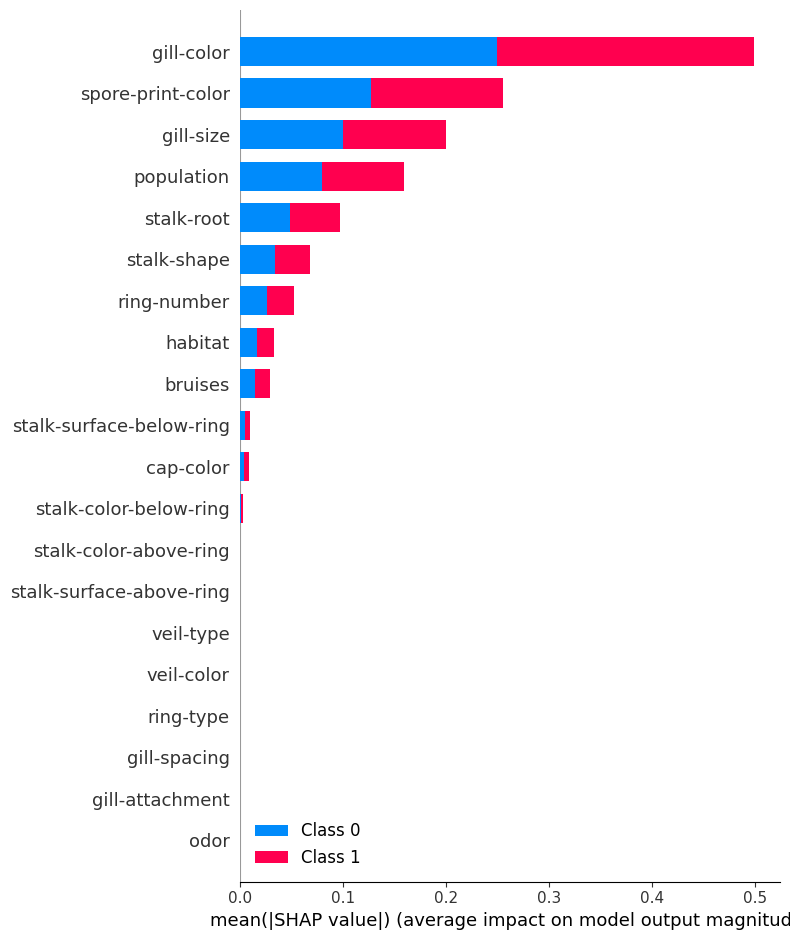

In [28]:
shap.initjs()
shap.summary_plot(shap_values_DT_0, X_test, plot_type="bar")



In [29]:
shap_values_DT_0

[array([[ 0.        ,  0.        ,  0.00598221, ...,  0.0795035 ,
         -0.03264861, -0.00450681],
        [ 0.        ,  0.        ,  0.0019914 , ...,  0.02933354,
         -0.00903828, -0.03226669],
        [ 0.        ,  0.        ,  0.00050872, ...,  0.02406195,
         -0.04772784,  0.01922899],
        ...,
        [ 0.        ,  0.        ,  0.00096579, ..., -0.25859848,
         -0.04666026, -0.00479579],
        [ 0.        ,  0.        ,  0.00096579, ..., -0.25859848,
         -0.04666026, -0.00479579],
        [ 0.        ,  0.        ,  0.00598221, ...,  0.08295583,
          0.09512726,  0.00747668]]),
 array([[ 0.        ,  0.        , -0.00598221, ..., -0.0795035 ,
          0.03264861,  0.00450681],
        [ 0.        ,  0.        , -0.0019914 , ..., -0.02933354,
          0.00903828,  0.03226669],
        [ 0.        ,  0.        , -0.00050872, ..., -0.02406195,
          0.04772784, -0.01922899],
        ...,
        [ 0.        ,  0.        , -0.00096579, ...,  

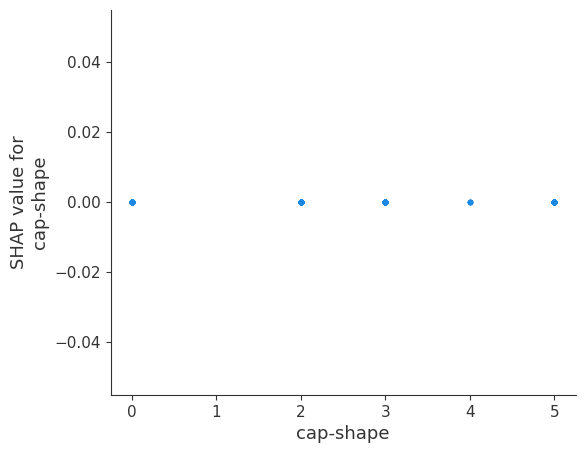

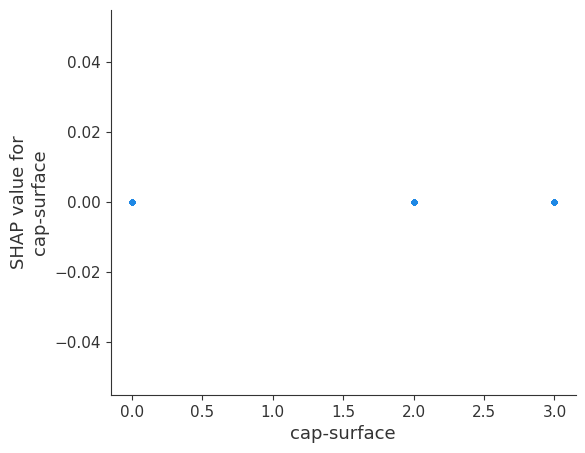

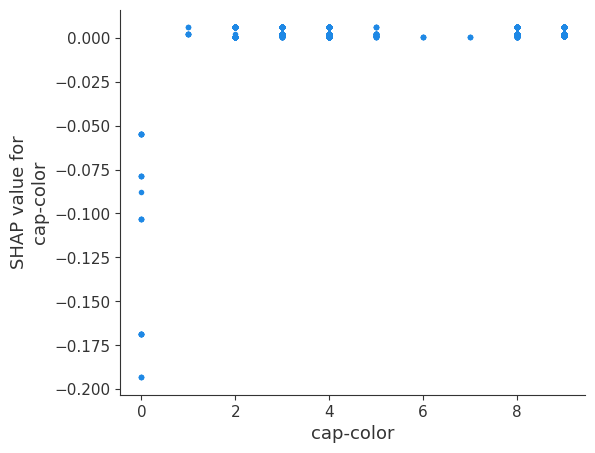

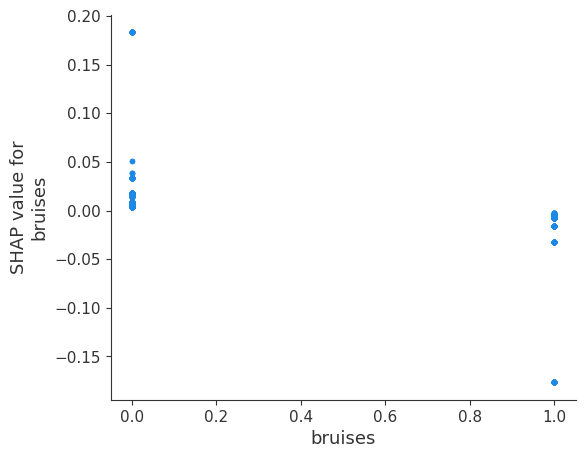

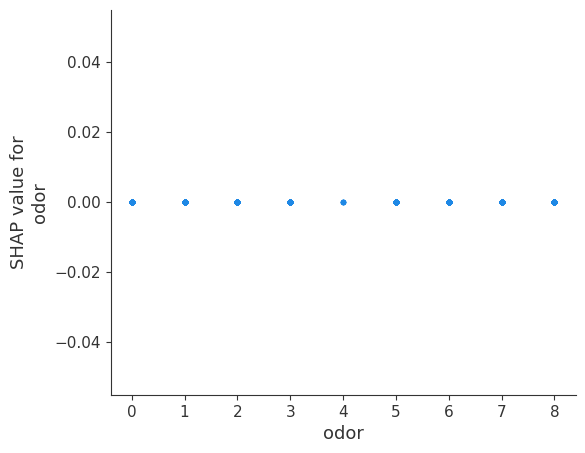

...

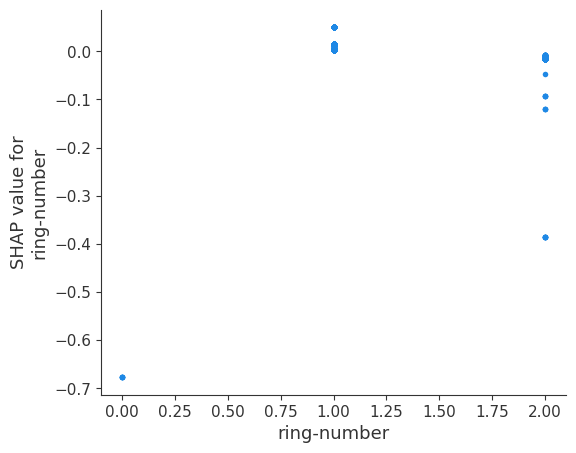

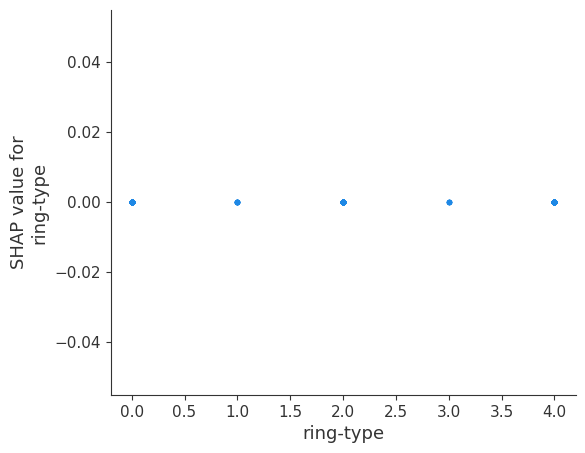

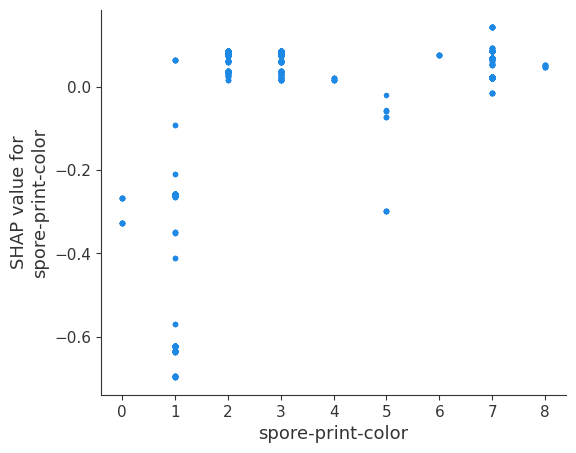

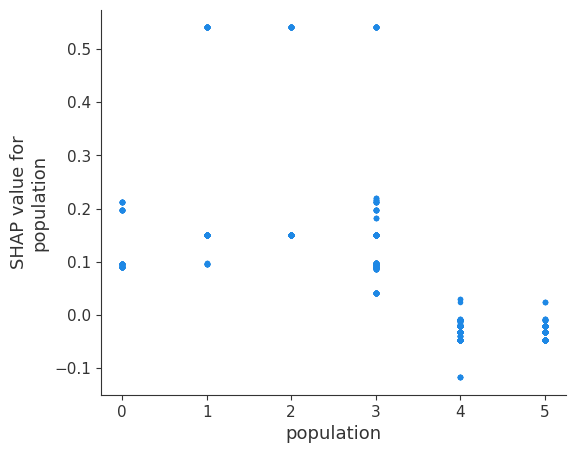

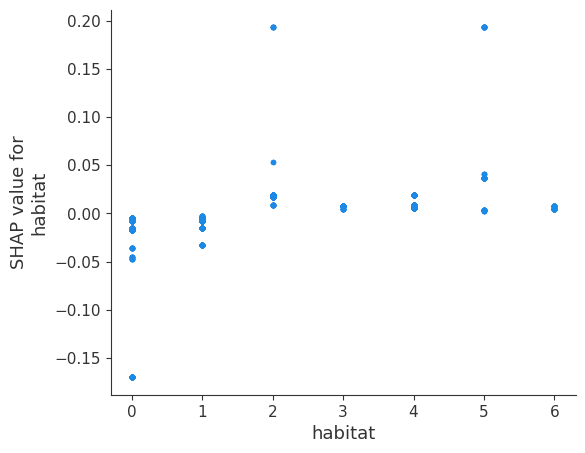

In [30]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_DT_0[0], X_test,interaction_index = None )

# GradientBoosting Classifier

In [31]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

In [32]:
gbc0 = GradientBoostingClassifier(random_state=10,validation_fraction=0.2)
gbc0.fit(X_train,y_train)


GradientBoostingClassifier(random_state=10, validation_fraction=0.2)

In [33]:


# prediction
y_pred_gbc = gbc0.predict(X_test)

gbc0.score(X_test, y_pred_gbc)


1.0

In [34]:
print(classification_report(y_test,y_pred_gbc))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       845
           1       1.00      1.00      1.00       780

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



In [35]:
shap.initjs()
explainer_GBC_0 = shap.Explainer(gbc0)
shap_values_GBC_0 = explainer_GBC_0.shap_values(X_test)
shap.force_plot(explainer_GBC_0.expected_value, shap_values_GBC_0, X_test)



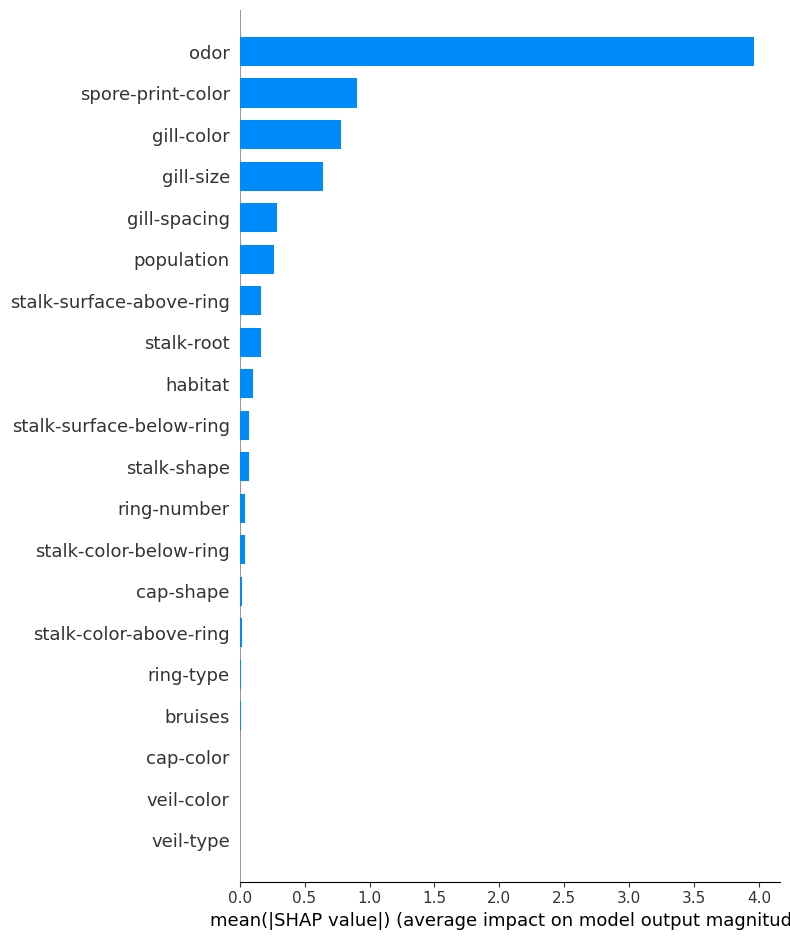

In [36]:
shap.initjs()
shap.summary_plot(shap_values_GBC_0, X_test, plot_type="bar")

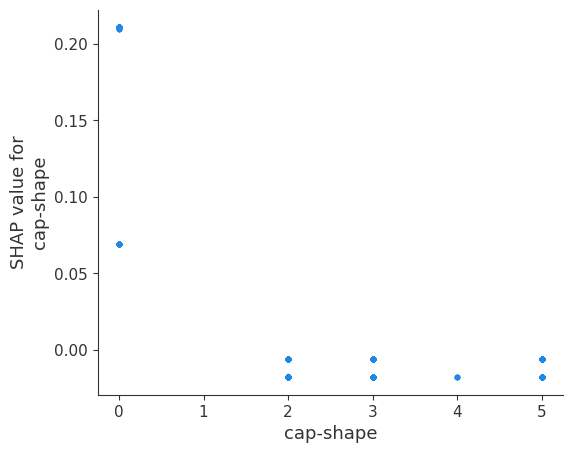

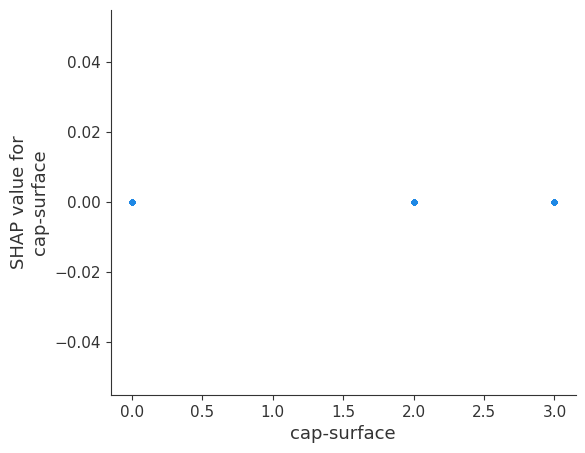

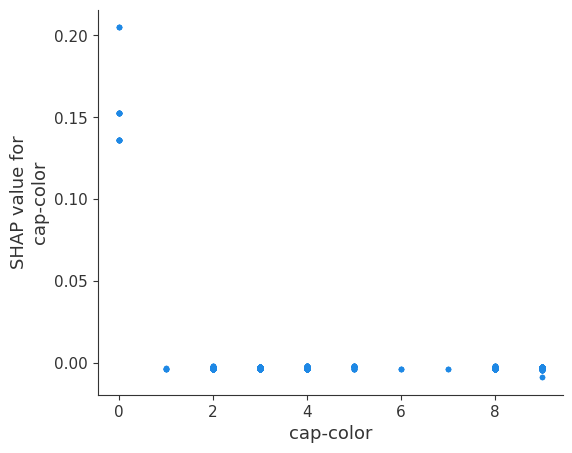

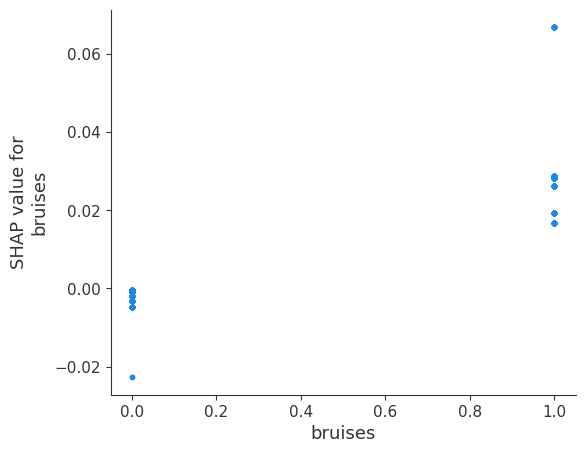

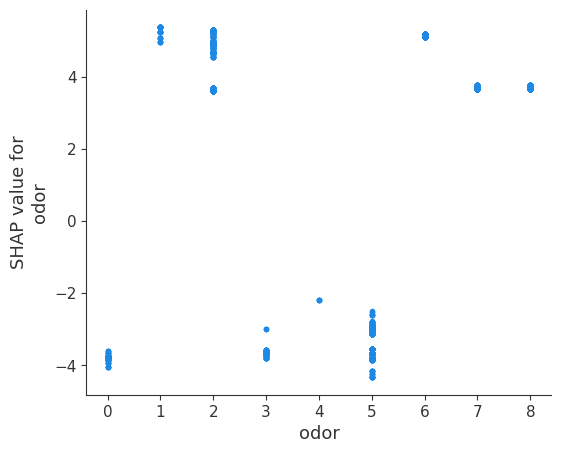

...

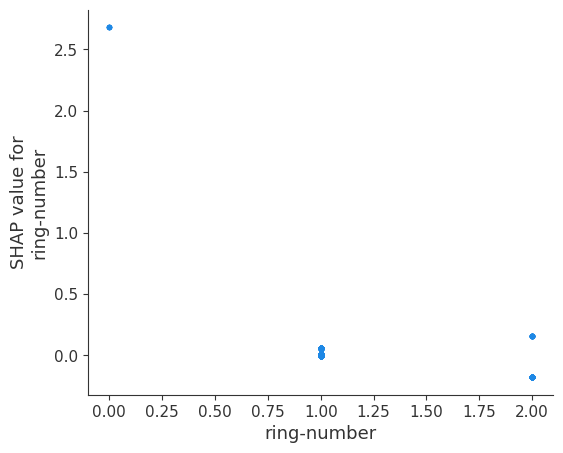

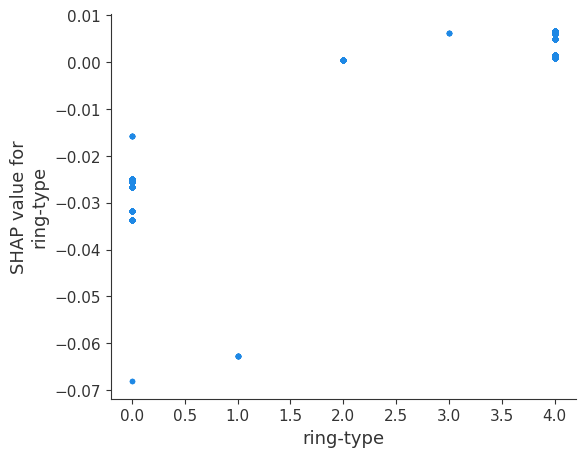

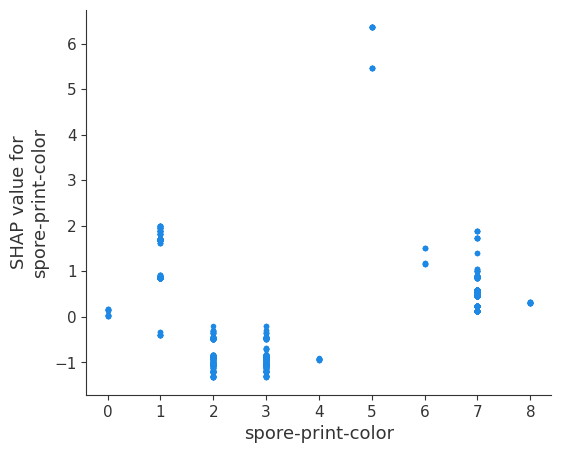

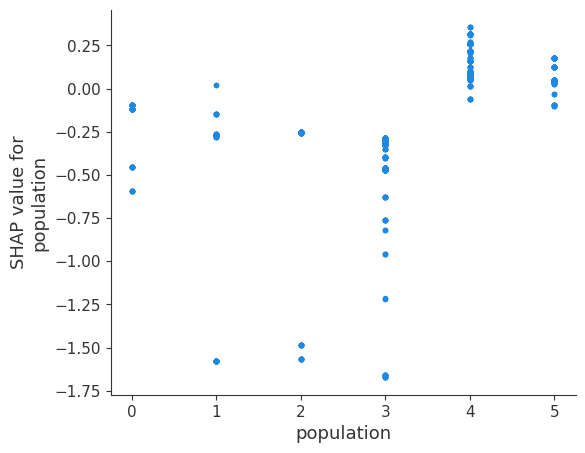

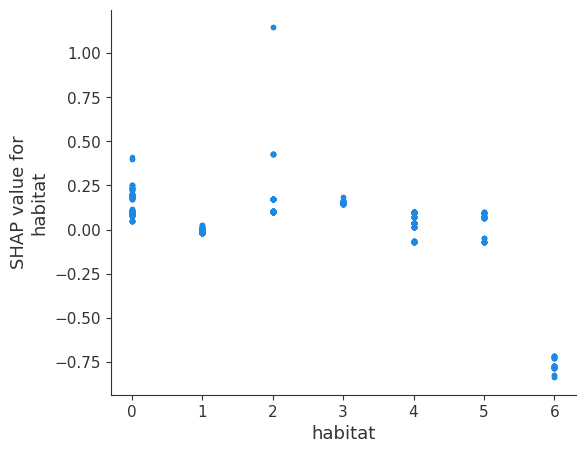

In [37]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_GBC_0, X_test, interaction_index = None)

# Noise Addition

In [38]:
from sklearn.utils import shuffle
def noise_addition(f):
  # f means the level of noise
  data_noise = pd.read_csv('../content/datasets/uciml/mushroom-classification/mushrooms.csv')
  X_shuffled = shuffle(data_noise,random_state = 42)
  #generate random parameters
  random_cap_shape = ['b','c','x','f','k','s']
  random_cap_surface = ['f','g','y','s']
  random_cap_color = ['b','c','g','r','p','u','e','w','y','n']
  random_bruises = ['t','f']
  random_odor = ['a','l','c','y','f','m','n','p','s']
  random_gill_attachment = ['a','d','f','n']
  random_gill_spacing = ['c','w','d']
  random_gill_size = ['b','n']
  random_gill_color = ['b','p']
  random_stalk_shape = ['t','e']
  random_stalk_root = ['b','c','u','e','z','r','?']
  random_stalk_SAR = ['f','y','k','s']
  random_stalk_SBR = ['f','y','k','s']
  random_stalk_CAR = ['n','b','c','g','o','p','e','w','y']
  random_stalk_CBR = ['n','b','c','g','o','p','e','w','y']
  random_veil_type = ['p','u']
  random_veil_color = ['n','o','w','y']
  random_ring_number = ['n','o','t']
  random_ring_type = ['c','e','f','l','n','p','s','z']
  random_spore_print_color = ['k','b','n','h','r','o','u','w','y']
  random_population = ['a','c','n','s','v','y']
  random_habitat = ['g','l','m','p','u','w','d']
  num_samples_to_change = int( 8124*f )
  for i in range(num_samples_to_change):
    new_cap_shape = np.random.choice(random_cap_shape)
    new_cap_surface = np.random.choice(random_cap_surface)
    new_cap_color = np.random.choice(random_cap_color)
    new_bruises = np.random.choice(random_bruises)
    new_odor = np.random.choice(random_odor)
    new_gill_attachment = np.random.choice(random_gill_attachment)
    new_gill_spacing = np.random.choice(random_gill_spacing)
    new_gill_size = np.random.choice(random_gill_size)
    new_gill_color = np.random.choice(random_gill_color)
    new_stalk_shape = np.random.choice(random_stalk_shape)
    new_stalk_root = np.random.choice(random_stalk_root)
    new_stalk_SAR = np.random.choice(random_stalk_SAR)
    new_stalk_SBR = np.random.choice(random_stalk_SBR)
    new_stalk_CAR = np.random.choice(random_stalk_CAR)
    new_stalk_CBR = np.random.choice(random_stalk_CBR)
    new_veil_type = np.random.choice(random_veil_type)
    new_veil_color = np.random.choice(random_veil_color)
    new_ring_number = np.random.choice(random_ring_number)
    new_ring_type = np.random.choice(random_ring_type)
    new_spore_print_color = np.random.choice(random_spore_print_color)
    new_population = np.random.choice(random_population)
    new_habitat = np.random.choice(random_habitat)
    for i in range(num_samples_to_change):
      X_shuffled.at[i, 'cap-shape'] = new_cap_shape
      X_shuffled.at[i, 'cap-surface'] = new_cap_surface
      X_shuffled.at[i, 'cap-color'] = new_cap_color
      X_shuffled.at[i, 'bruises'] = new_bruises
      X_shuffled.at[i, 'odor'] = new_odor
      X_shuffled.at[i, 'gill-attachment'] = new_gill_attachment
      X_shuffled.at[i, 'gill-spacing'] = new_gill_spacing
      X_shuffled.at[i, 'gill-size'] = new_gill_size
      X_shuffled.at[i, 'gill-color'] = new_gill_color
      X_shuffled.at[i, 'stalk-shape'] = new_stalk_shape
      X_shuffled.at[i, 'stalk-root'] = new_stalk_root
      X_shuffled.at[i, 'stalk-surface-above-ring'] = new_stalk_SAR
      X_shuffled.at[i, 'stalk-surface-below-ring'] = new_stalk_SBR
      X_shuffled.at[i, 'stalk-color-above-ring'] = new_stalk_CAR
      X_shuffled.at[i, 'stalk-color-below-ring'] = new_stalk_CBR
      X_shuffled.at[i, 'veil-type'] = new_veil_type
      X_shuffled.at[i, 'veil-color'] = new_veil_color
      X_shuffled.at[i, 'ring-number'] = new_ring_number
      X_shuffled.at[i, 'ring-type'] = new_ring_type
      X_shuffled.at[i, 'spore-print-color'] = new_spore_print_color
      X_shuffled.at[i, 'population'] = new_population
      X_shuffled.at[i, 'habitat'] = new_habitat

    return X_shuffled












In [215]:
print(data.groupby('odor').size())

odor
0     400
1     192
2    2160
3     400
4      36
5    3528
6     256
7     576
8     576
dtype: int64


# noise level 5%

In [39]:
data_5 = noise_addition(0.05)
print(data_5.groupby('odor').size())

odor
a     253
c     192
f    2160
l     259
m      36
n    3453
p     213
s     576
y     982
dtype: int64


In [40]:
labelencoder=LabelEncoder()
for col in data_5.columns:
    data_5[col] = labelencoder.fit_transform(data_5[col])

data_5.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
1971,0,2,0,4,0,5,2,1,0,3,...,0,7,7,0,2,1,0,3,3,1
6654,1,2,2,2,0,8,2,0,1,0,...,2,6,6,0,2,1,0,7,4,2
5606,1,5,3,4,0,2,2,0,1,0,...,2,7,6,0,2,1,0,7,4,2
3332,0,2,3,3,1,5,2,0,0,5,...,2,3,6,0,2,1,4,3,5,0
6988,1,2,2,2,0,7,2,0,1,0,...,2,6,6,0,2,1,0,7,4,2


In [41]:
X_5 = data_5.iloc[:,1:23]  # all rows, all the features and no labels
y_5 = data_5.iloc[:, 0]  # all rows, label only
X_5.head()
y_5.head()

1971    0
6654    1
5606    1
3332    0
6988    1
Name: class, dtype: int64

In [42]:
X5_train, X5_test, y5_train, y5_test = train_test_split(X_5,y_5,test_size=0.2,random_state=42)

In [44]:
# model
model_tree5 = DecisionTreeClassifier()
model_tree5.fit(X5_train, y5_train)

# prediction
y_pred5 = model_tree5.predict(X5_test)
model_tree5.score(X5_test, y_pred5)


1.0

In [45]:
print(classification_report(y5_test,y_pred5))

              precision    recall  f1-score   support

           0       0.99      1.00      1.00       831
           1       1.00      0.99      1.00       794

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



In [46]:
shap.initjs()
explainer_DT_5 = shap.TreeExplainer(model_tree5)
shap_values_DT_5 = explainer_DT_5.shap_values(X5_test)
shap.force_plot(explainer_DT_5.expected_value[0], shap_values_DT_5[0], X5_test)


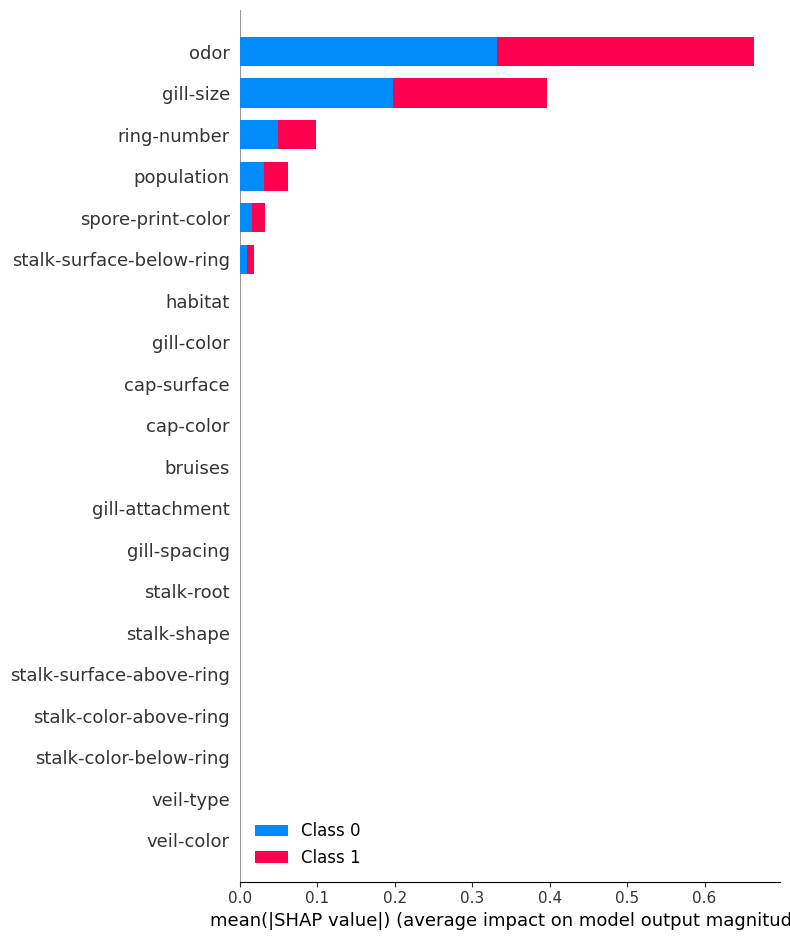

In [48]:
shap.initjs()
shap.summary_plot(shap_values_DT_5, X5_test, plot_type="bar")

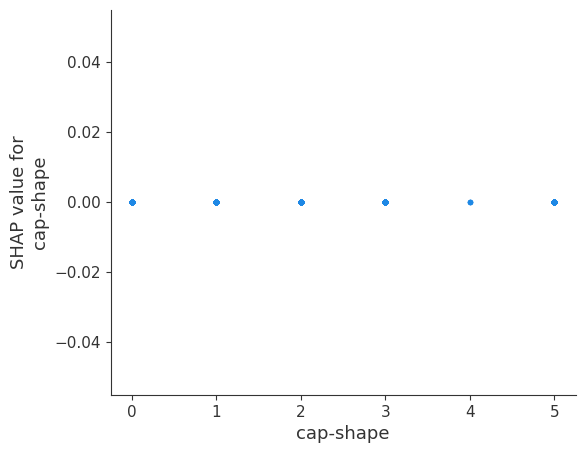

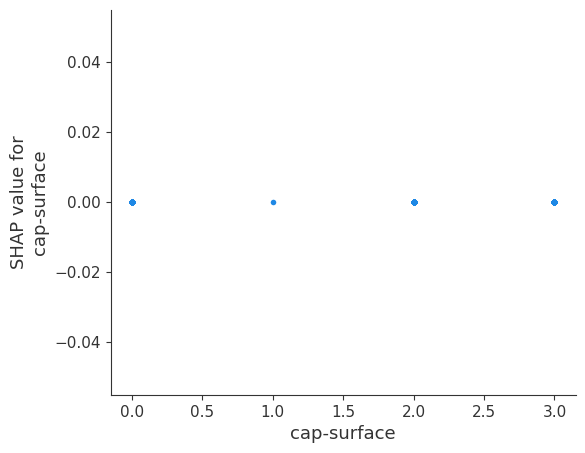

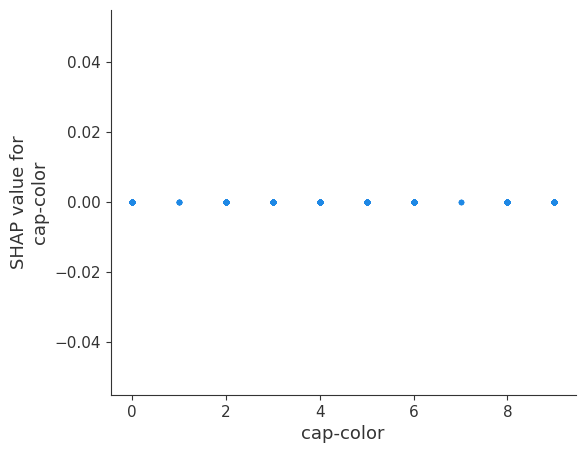

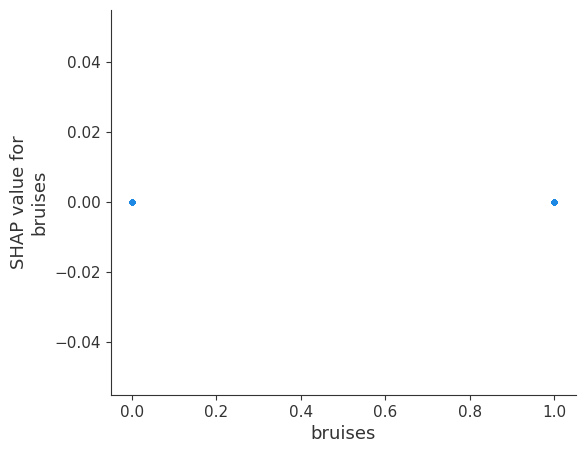

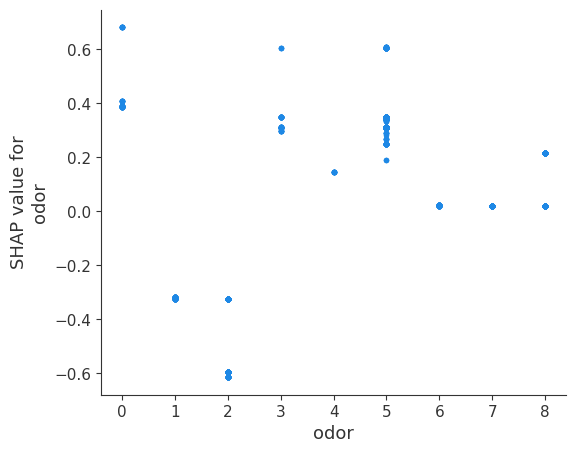

...

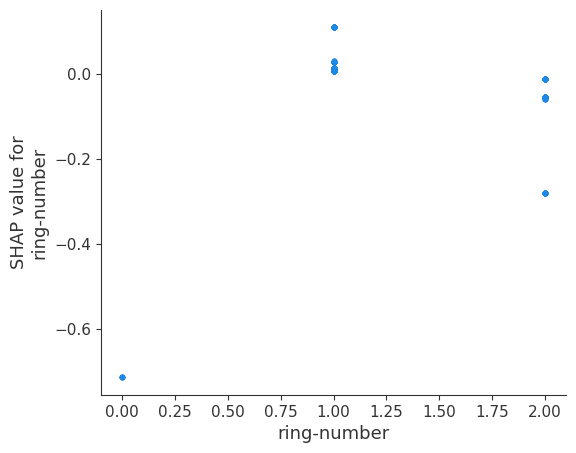

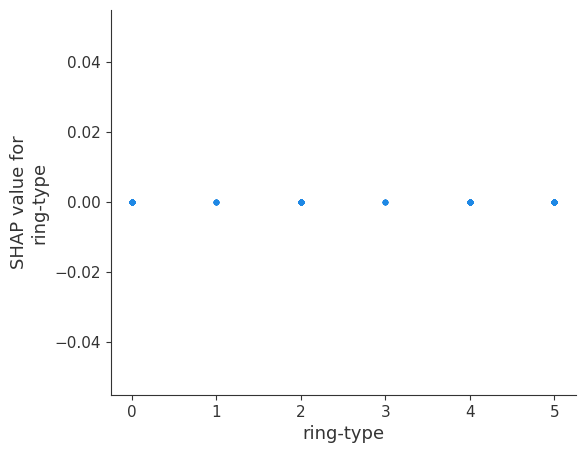

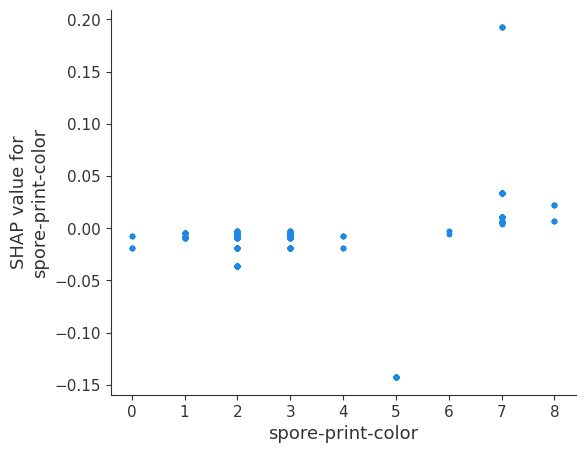

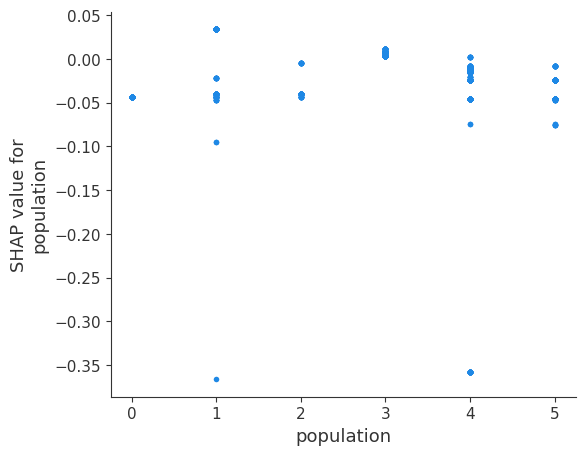

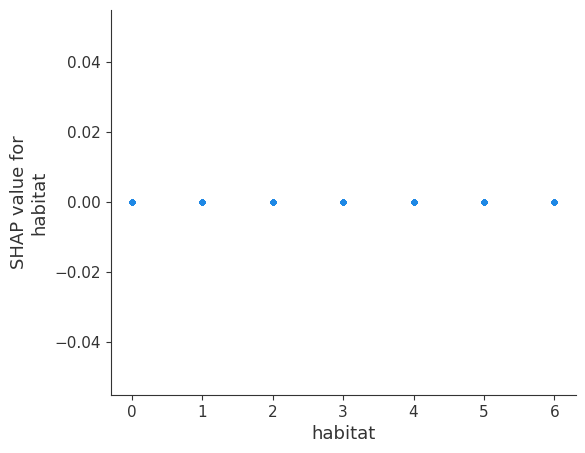

In [49]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_DT_5[0], X5_test,interaction_index = None )

In [50]:
gbc5 = GradientBoostingClassifier(random_state=10,validation_fraction=0.2)
gbc5.fit(X5_train,y5_train)


GradientBoostingClassifier(random_state=10, validation_fraction=0.2)

In [52]:


# prediction
y_pred_gbc5 = gbc5.predict(X5_test)

gbc5.score(X5_test, y_pred_gbc5)
# result
1

1

In [53]:
print(classification_report(y5_test,y_pred_gbc5))

              precision    recall  f1-score   support

           0       0.99      1.00      1.00       831
           1       1.00      0.99      1.00       794

    accuracy                           1.00      1625
   macro avg       1.00      1.00      1.00      1625
weighted avg       1.00      1.00      1.00      1625



In [55]:
shap.initjs()
explainer_GBC_5 = shap.TreeExplainer(gbc5)
shap_values_GBC_5 = explainer_GBC_5.shap_values(X5_test)
shap.force_plot(explainer_GBC_5.expected_value[0], shap_values_GBC_5, X5_test)


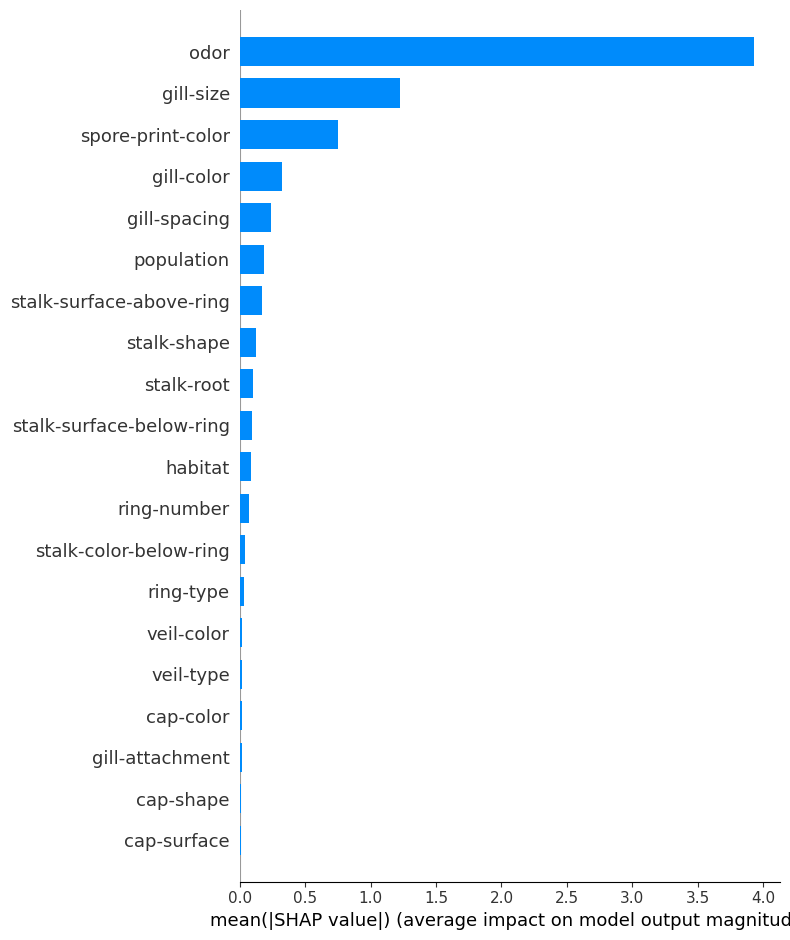

In [56]:
shap.initjs()
shap.summary_plot(shap_values_GBC_5, X5_test, plot_type="bar")

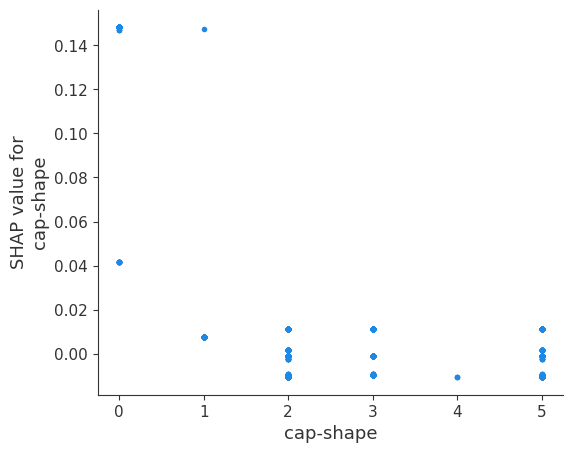

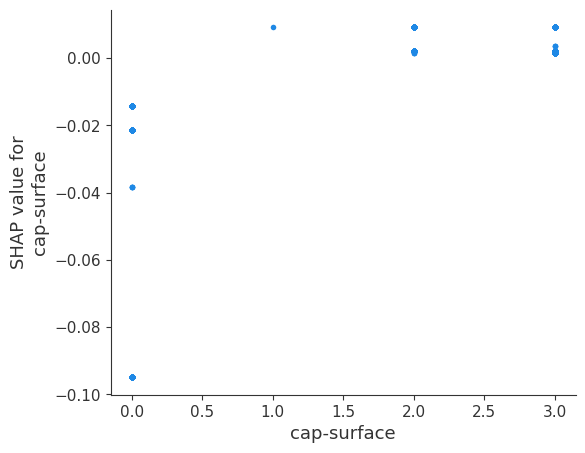

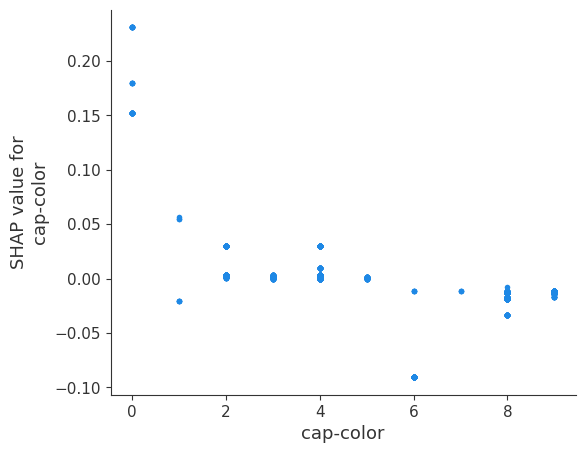

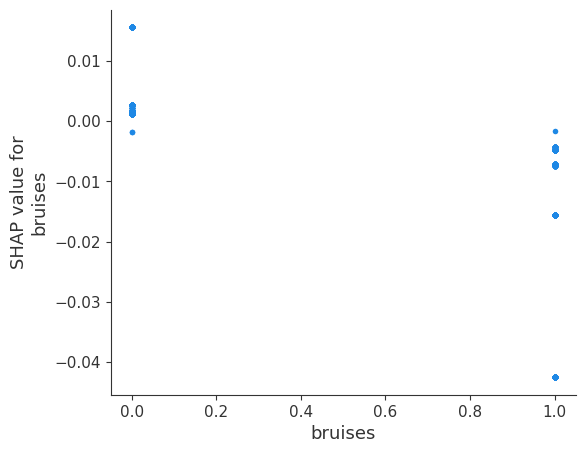

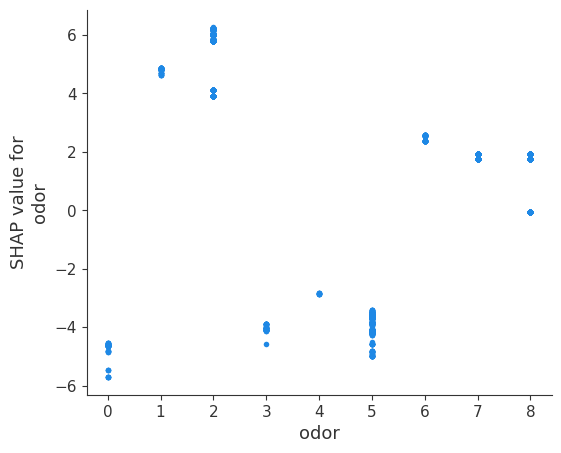

...

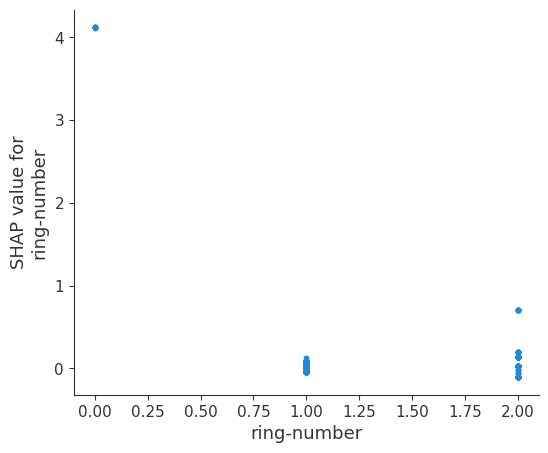

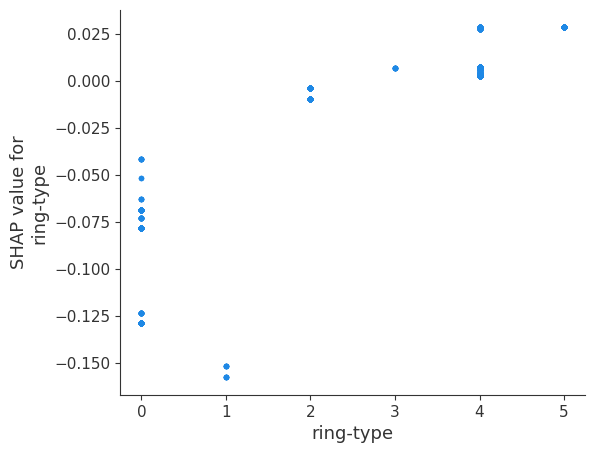

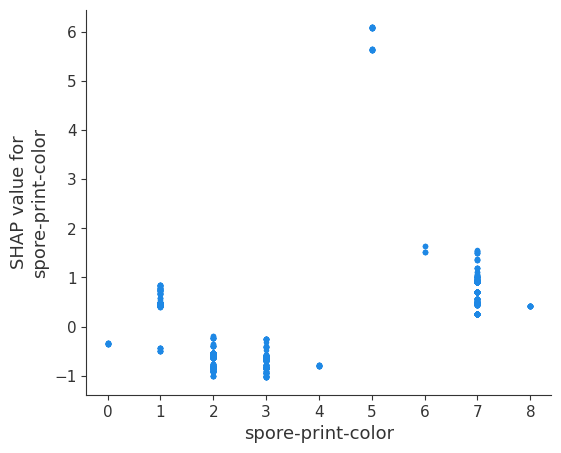

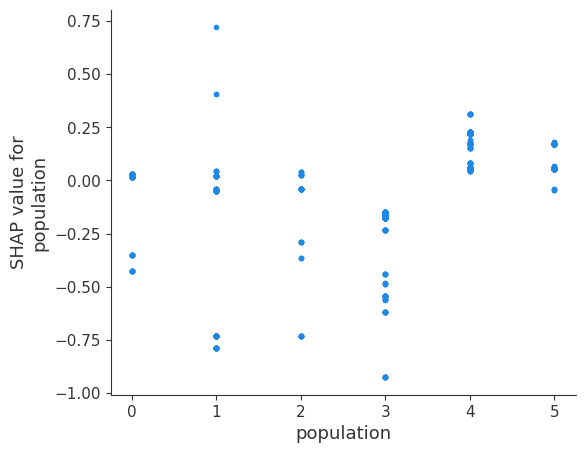

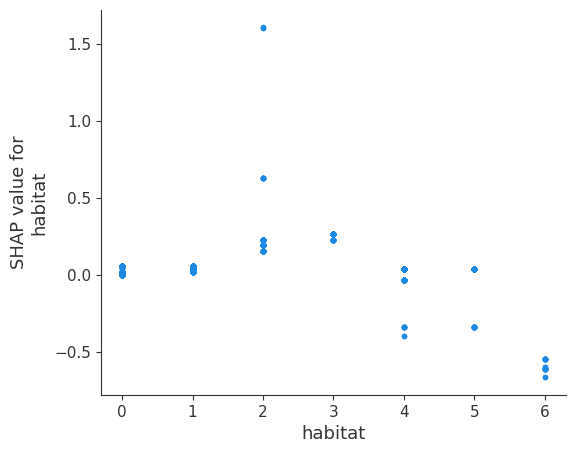

In [57]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_GBC_5, X5_test,interaction_index = None )

# noise level 10


In [58]:
data_10 = noise_addition(0.1)
print(data_10.groupby('odor').size())

odor
a     104
c    1004
f    2160
l     119
m      36
n    3376
p     173
s     576
y     576
dtype: int64


In [59]:
labelencoder=LabelEncoder()
for col in data_10.columns:
    data_10[col] = labelencoder.fit_transform(data_10[col])

data_10.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
1971,0,2,0,4,0,5,1,1,0,3,...,0,7,7,0,2,1,0,3,3,1
6654,1,2,2,2,0,8,1,0,1,0,...,2,6,6,0,2,1,0,7,4,2
5606,1,5,3,4,0,2,1,0,1,0,...,2,7,6,0,2,1,0,7,4,2
3332,0,2,3,3,1,5,1,0,0,5,...,2,3,6,0,2,1,4,3,5,0
6988,1,2,2,2,0,7,1,0,1,0,...,2,6,6,0,2,1,0,7,4,2


In [62]:
X_10 = data_10.iloc[:,1:23]  # all rows, all the features and no labels
y_10 = data_10.iloc[:, 0]  # all rows, label only
X_10.head()
y_10.head()

1971    0
6654    1
5606    1
3332    0
6988    1
Name: class, dtype: int64

In [63]:
X10_train, X10_test, y10_train, y10_test = train_test_split(X_10,y_10,test_size=0.2,random_state=42)

In [64]:
# model
model_tree10 = DecisionTreeClassifier()
model_tree10.fit(X10_train, y10_train)

# prediction
y_pred10 = model_tree10.predict(X10_test)

model_tree10.score(X10_test, y_pred10)


1.0

In [65]:
print(classification_report(y10_test,y_pred10))

              precision    recall  f1-score   support

           0       0.97      1.00      0.99       849
           1       1.00      0.97      0.99       776

    accuracy                           0.99      1625
   macro avg       0.99      0.99      0.99      1625
weighted avg       0.99      0.99      0.99      1625



In [66]:
shap.initjs()
explainer_DT_10 = shap.TreeExplainer(model_tree10)
shap_values_DT_10 = explainer_DT_10.shap_values(X10_test)
shap.force_plot(explainer_DT_10.expected_value[0], shap_values_DT_10[0], X10_test)


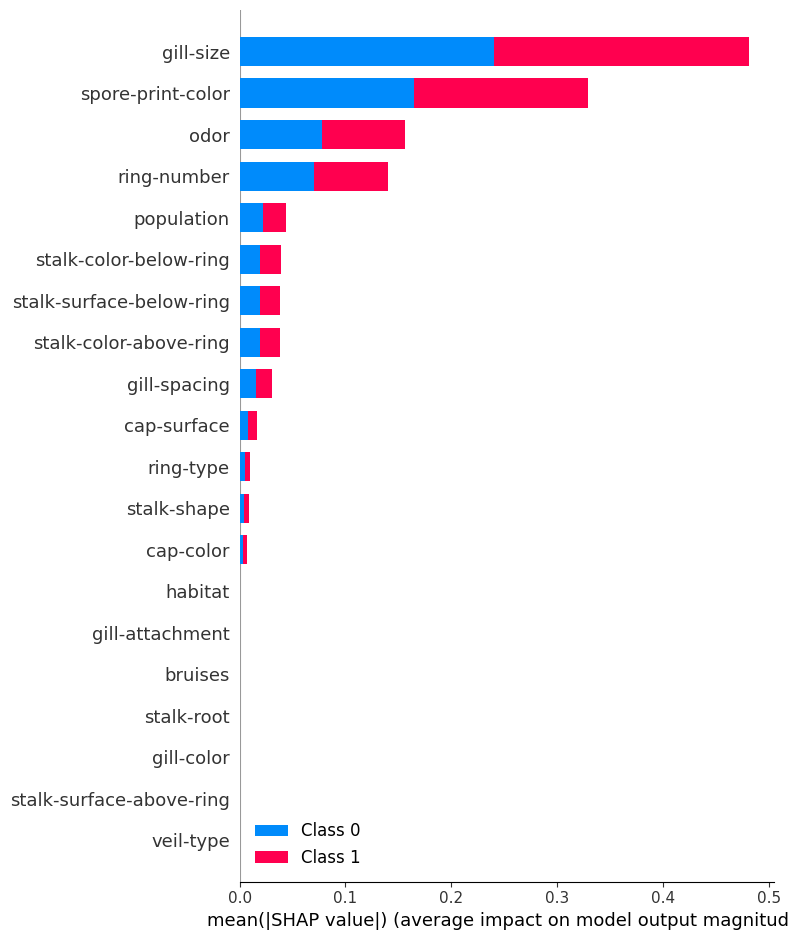

In [67]:
shap.initjs()
shap.summary_plot(shap_values_DT_10, X10_test, plot_type="bar")

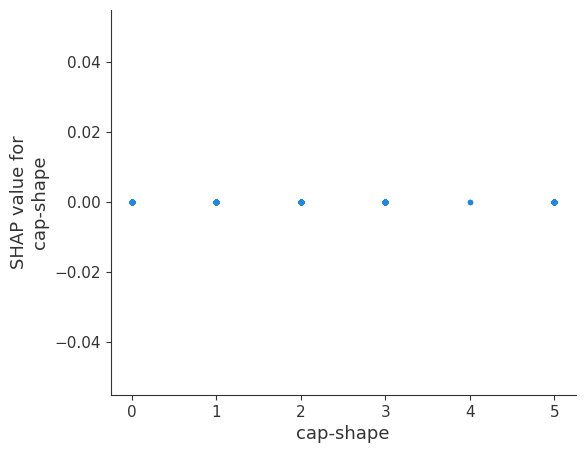

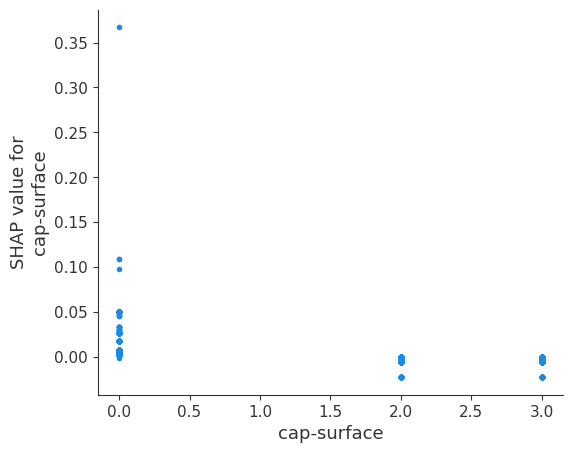

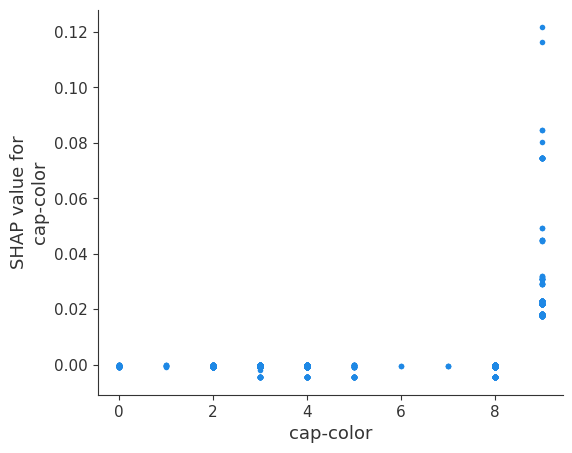

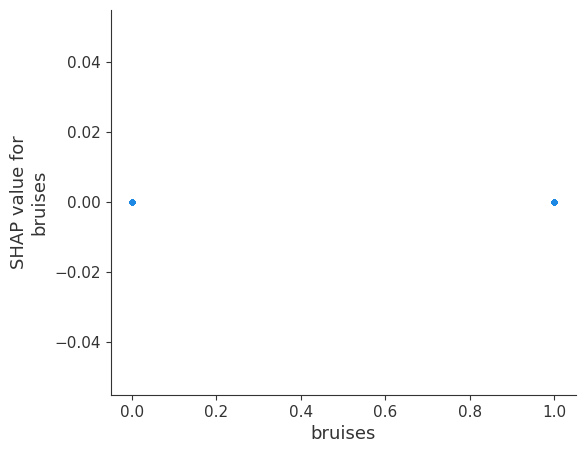

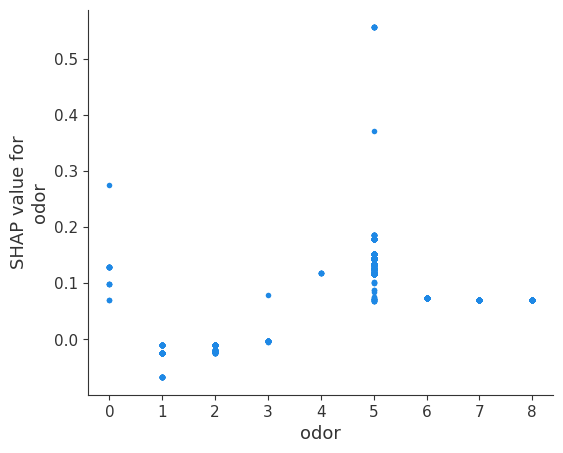

...

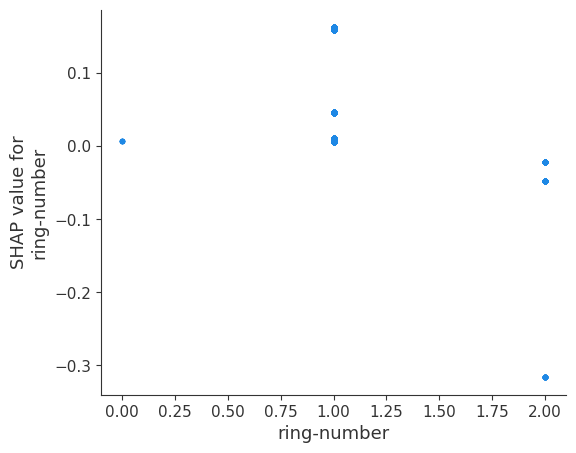

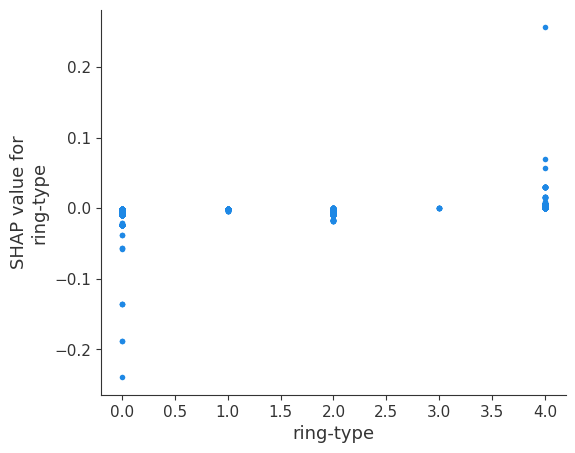

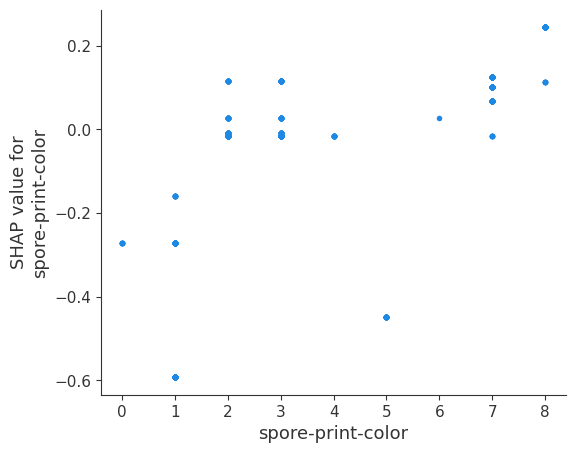

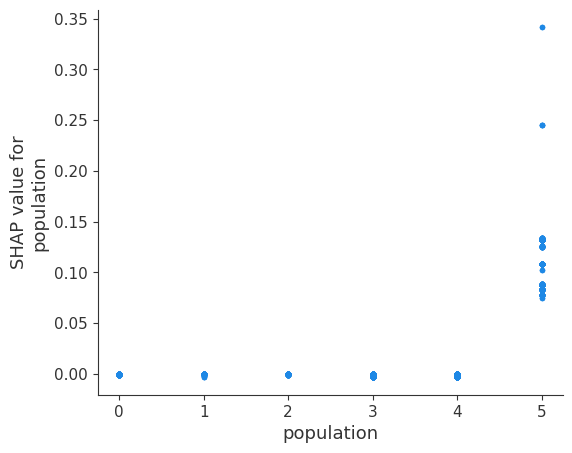

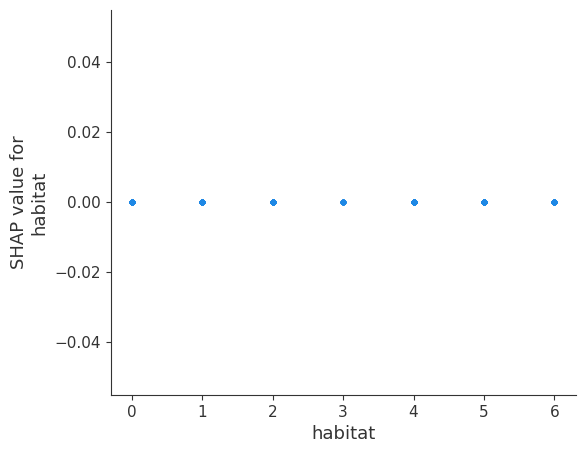

In [68]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_DT_10[0], X10_test,interaction_index = None )

In [69]:
gbc10 = GradientBoostingClassifier(random_state=10,validation_fraction=0.2)
gbc10.fit(X10_train,y10_train)


GradientBoostingClassifier(random_state=10, validation_fraction=0.2)

In [70]:


# prediction
y_pred_gbc10 = gbc10.predict(X10_test)

gbc10.score(X10_test, y_pred_gbc10)
# result
1

1

In [71]:
print(classification_report(y10_test,y_pred_gbc10))

              precision    recall  f1-score   support

           0       0.97      1.00      0.99       849
           1       1.00      0.97      0.99       776

    accuracy                           0.99      1625
   macro avg       0.99      0.99      0.99      1625
weighted avg       0.99      0.99      0.99      1625



In [72]:
shap.initjs()
explainer_GBC_10 = shap.TreeExplainer(gbc10)
shap_values_GBC_10 = explainer_GBC_10.shap_values(X10_test)
shap.force_plot(explainer_GBC_10.expected_value[0], shap_values_GBC_10, X10_test)


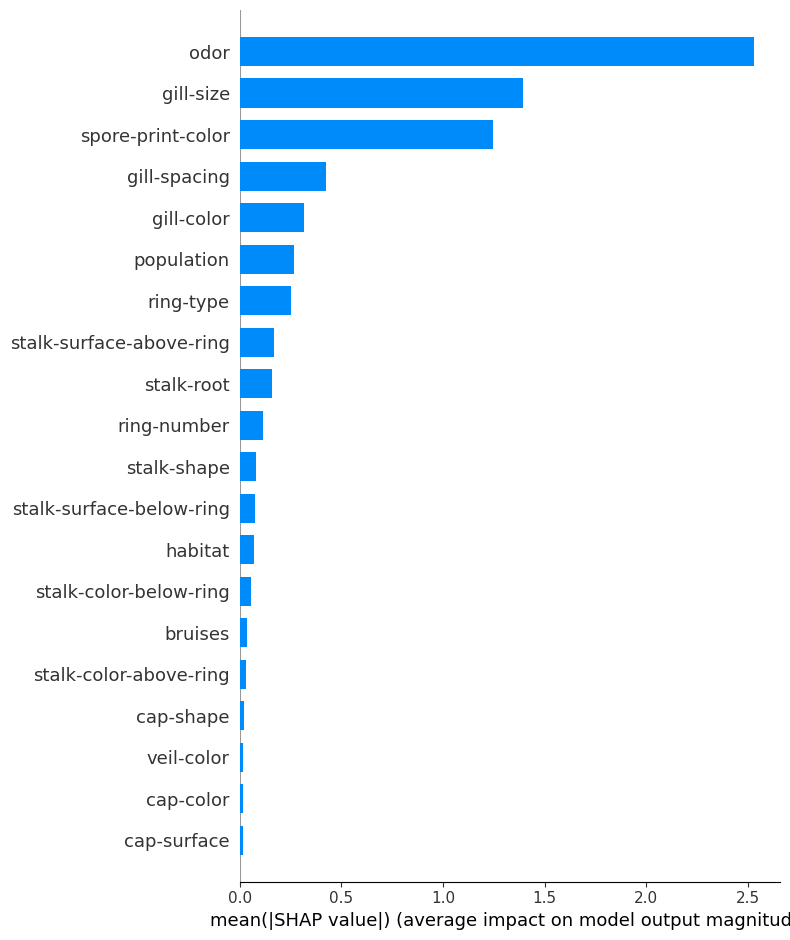

In [73]:
shap.initjs()
shap.summary_plot(shap_values_GBC_10, X10_test, plot_type="bar")

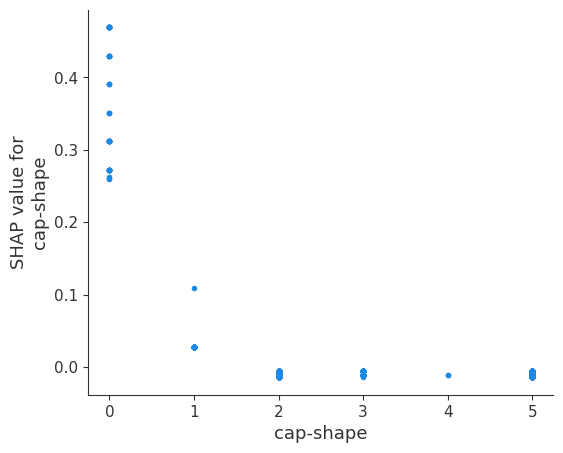

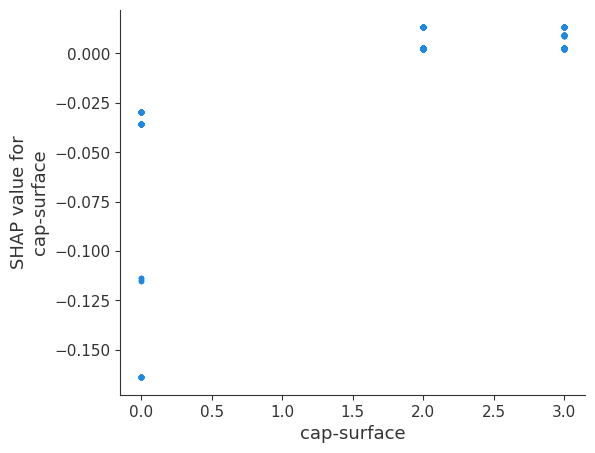

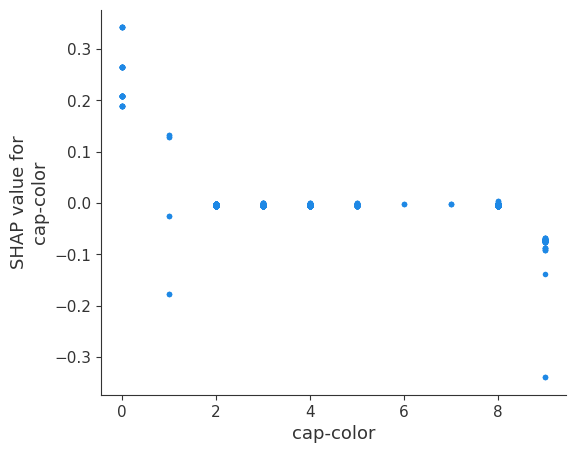

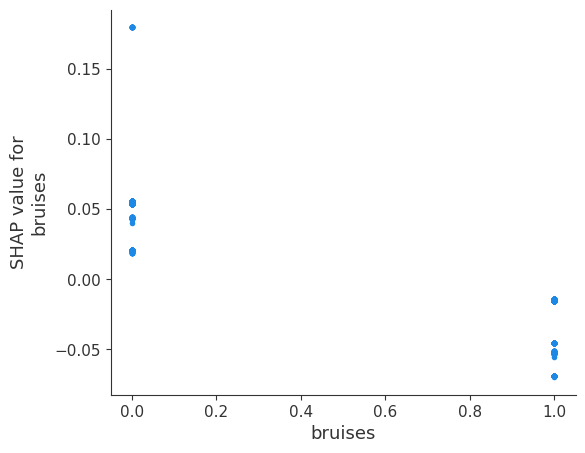

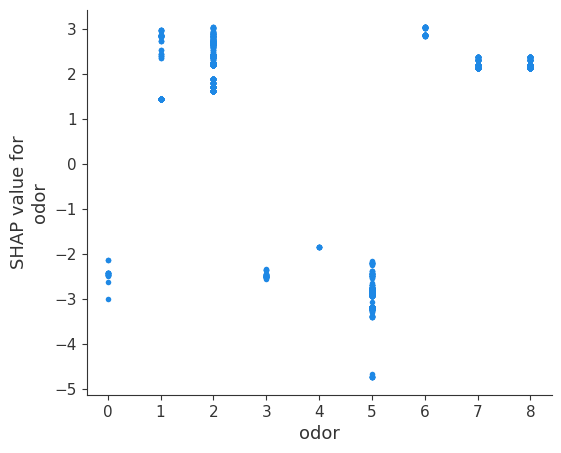

...

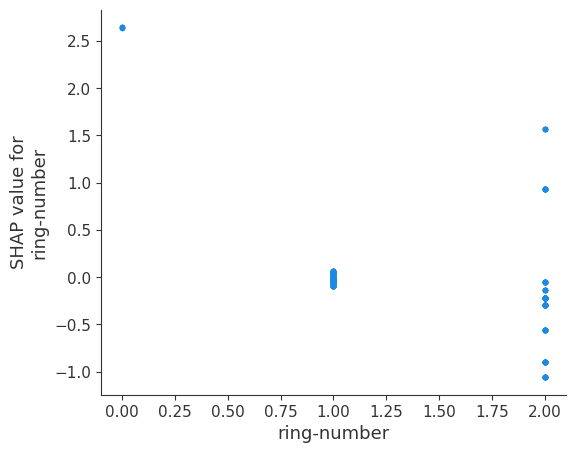

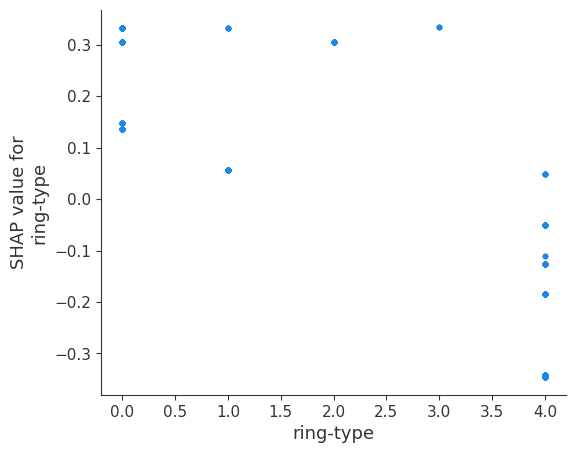

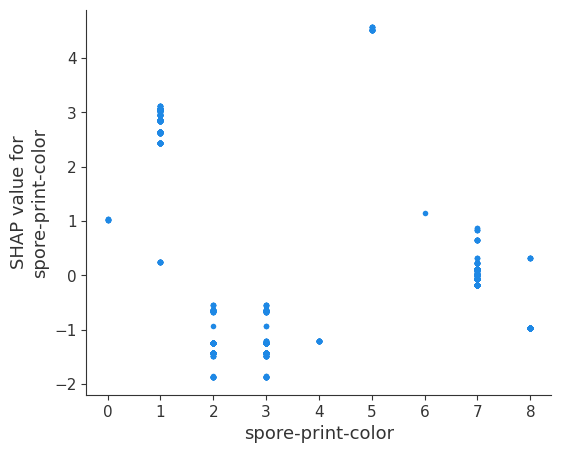

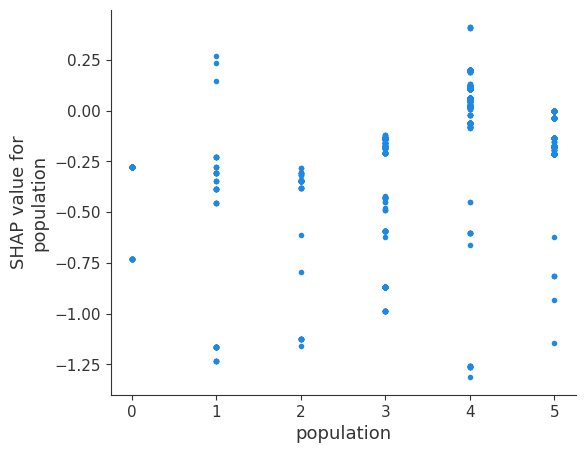

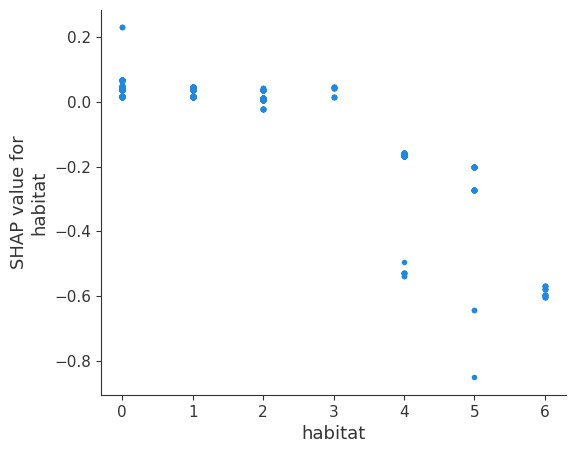

In [74]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_GBC_10, X10_test,interaction_index = None )



# noise level 15%

In [39]:
data_15 = noise_addition(0.15)
print(data_15.groupby('odor').size())

odor
a      33
c    1410
f    2160
l      31
m      36
n    3175
p     127
s     576
y     576
dtype: int64


In [40]:
labelencoder=LabelEncoder()
for col in data_15.columns:
    data_15[col] = labelencoder.fit_transform(data_15[col])

data_15.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
1971,0,2,0,4,0,5,2,1,0,3,...,0,7,7,0,2,1,0,3,3,1
6654,1,2,2,2,0,8,2,0,1,0,...,2,6,6,0,2,1,0,7,4,2
5606,1,4,3,4,0,2,2,0,1,0,...,2,7,6,0,2,1,0,7,4,2
3332,0,2,3,3,1,5,2,0,0,5,...,2,3,6,0,2,1,4,3,5,0
6988,1,2,2,2,0,7,2,0,1,0,...,2,6,6,0,2,1,0,7,4,2


In [41]:
X_15 = data_15.iloc[:,1:23]  # all rows, all the features and no labels
y_15 = data_15.iloc[:, 0]  # all rows, label only
X_15.head()
y_15.head()

1971    0
6654    1
5606    1
3332    0
6988    1
Name: class, dtype: int64

In [42]:
X15_train, X15_test, y15_train, y15_test = train_test_split(X_15,y_15,test_size=0.2,random_state=42)

In [43]:
# model
model_tree15 = DecisionTreeClassifier()
model_tree15.fit(X15_train, y15_train)

# prediction
y_pred15 = model_tree15.predict(X15_test)
model_tree15.score(X15_test, y_pred15)


1.0

In [44]:
print(classification_report(y15_test,y_pred15))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98       840
           1       1.00      0.95      0.97       785

    accuracy                           0.98      1625
   macro avg       0.98      0.98      0.98      1625
weighted avg       0.98      0.98      0.98      1625



In [45]:
shap.initjs()
explainer_DT_15 = shap.TreeExplainer(model_tree15)
shap_values_DT_15 = explainer_DT_15.shap_values(X15_test)
shap.force_plot(explainer_DT_15.expected_value[0], shap_values_DT_15[0], X15_test)


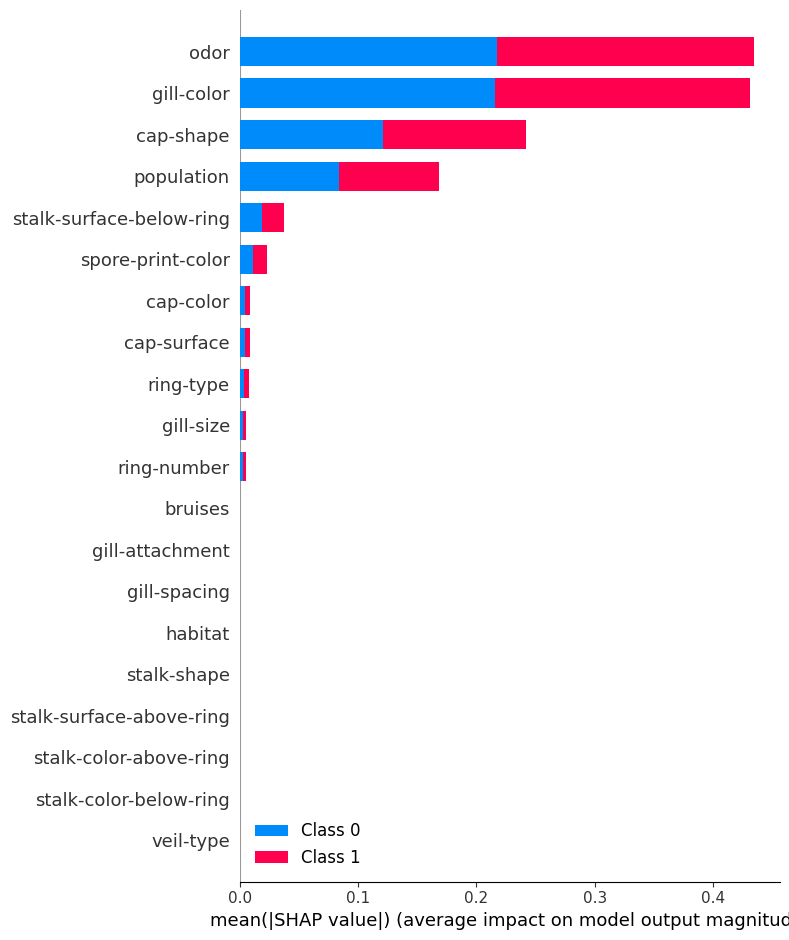

In [46]:
shap.initjs()
shap.summary_plot(shap_values_DT_15, X15_test, plot_type="bar")

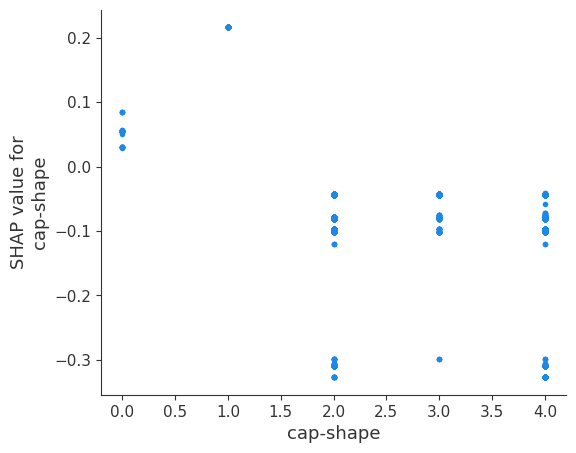

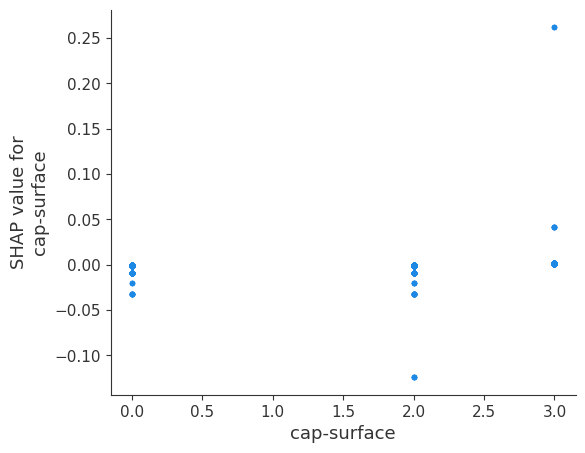

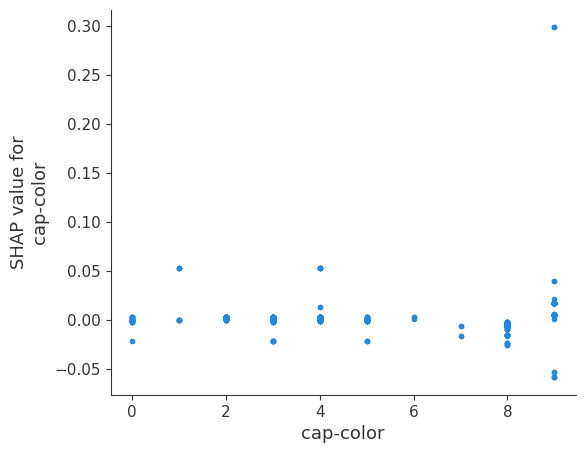

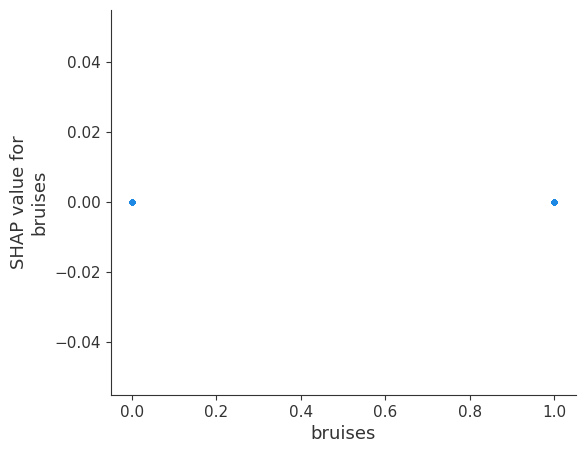

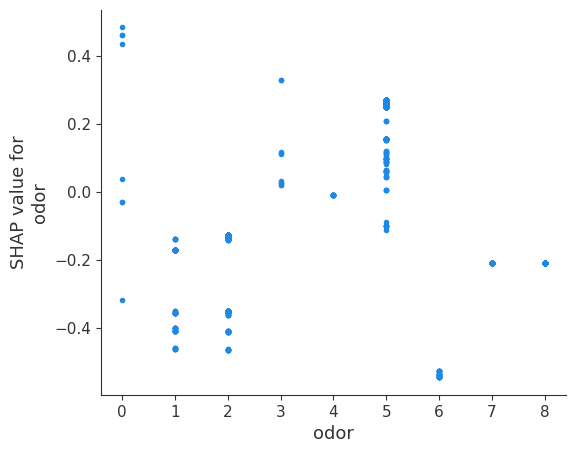

...

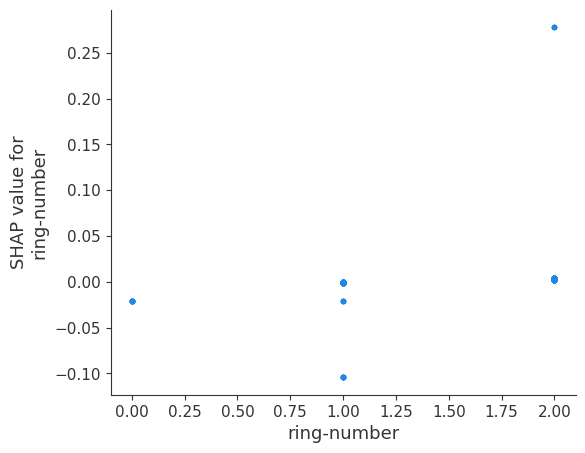

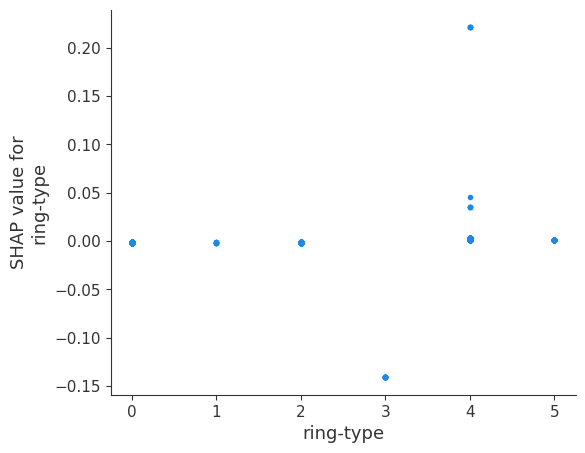

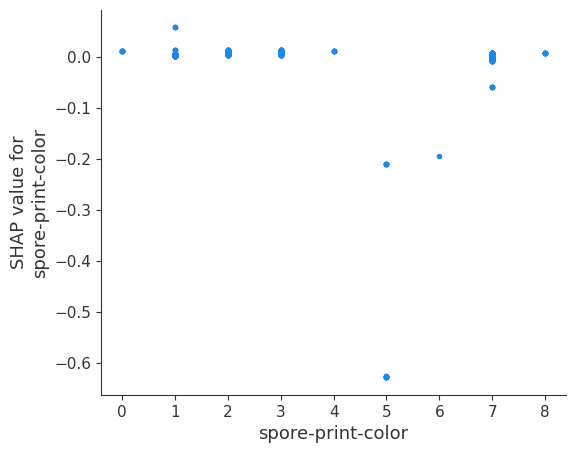

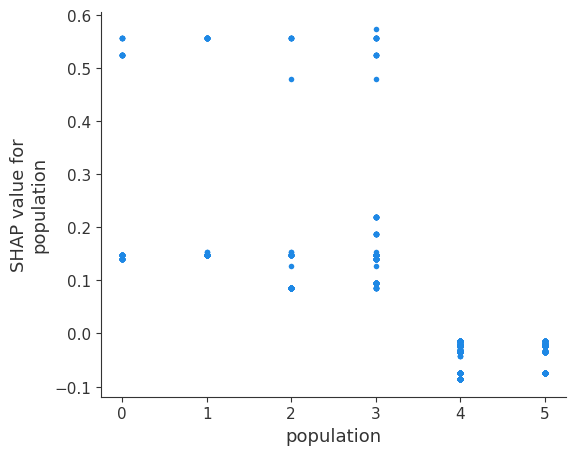

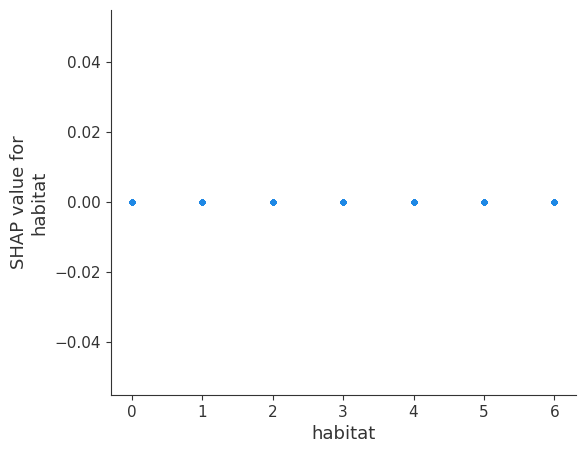

In [47]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_DT_15[0], X15_test,interaction_index = None )

In [48]:
gbc15 = GradientBoostingClassifier(random_state=10,validation_fraction=0.2)
gbc15.fit(X15_train,y15_train)


GradientBoostingClassifier(random_state=10, validation_fraction=0.2)

In [50]:


# prediction
y_pred_gbc15 = gbc15.predict(X15_test)

gbc15.score(X15_test, y_pred_gbc15)
# result
1

1

In [51]:
print(classification_report(y15_test,y_pred_gbc15))

              precision    recall  f1-score   support

           0       0.96      1.00      0.98       840
           1       1.00      0.95      0.98       785

    accuracy                           0.98      1625
   macro avg       0.98      0.98      0.98      1625
weighted avg       0.98      0.98      0.98      1625



In [53]:
shap.initjs()
explainer_GBC_15 = shap.TreeExplainer(gbc15)
shap_values_GBC_15 = explainer_GBC_15.shap_values(X15_test)
shap.force_plot(explainer_GBC_15.expected_value[0], shap_values_GBC_15, X15_test)


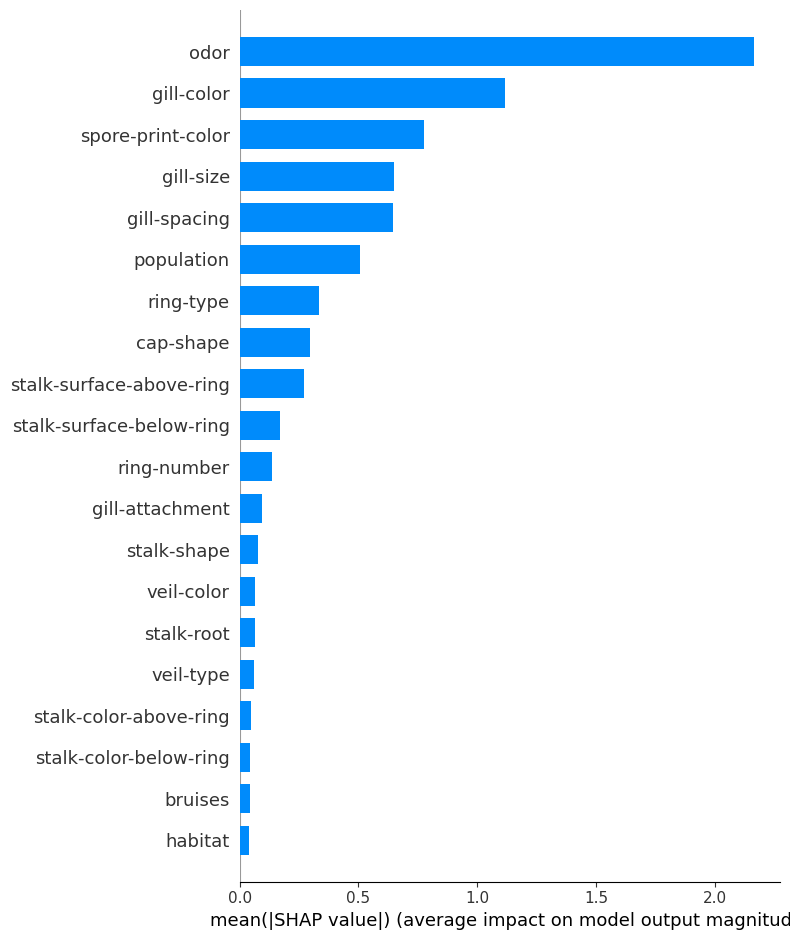

In [54]:
shap.initjs()
shap.summary_plot(shap_values_GBC_15, X15_test, plot_type="bar")

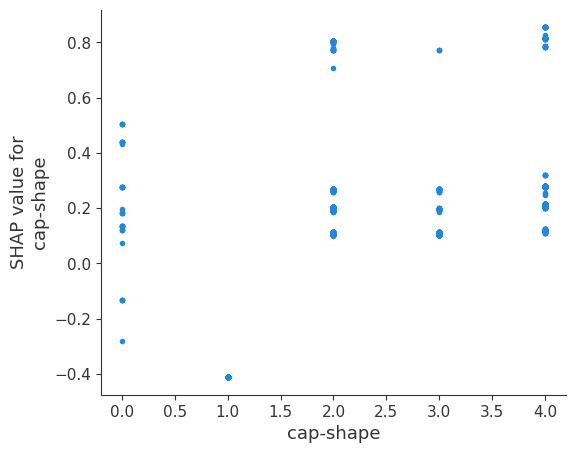

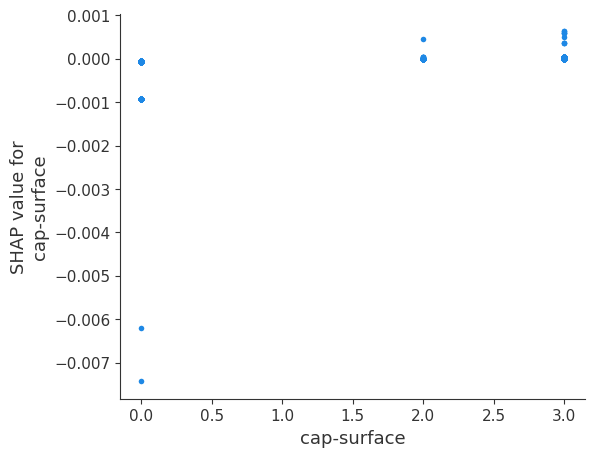

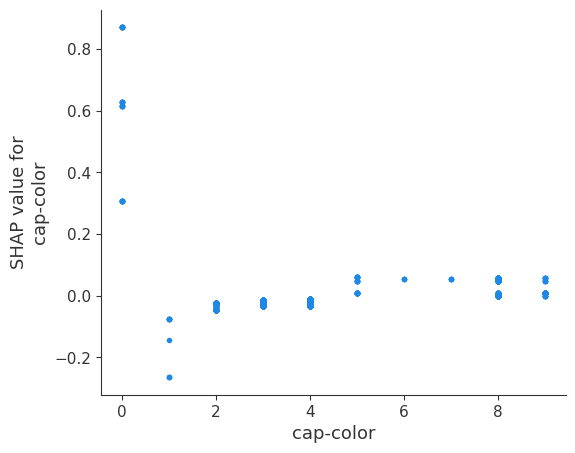

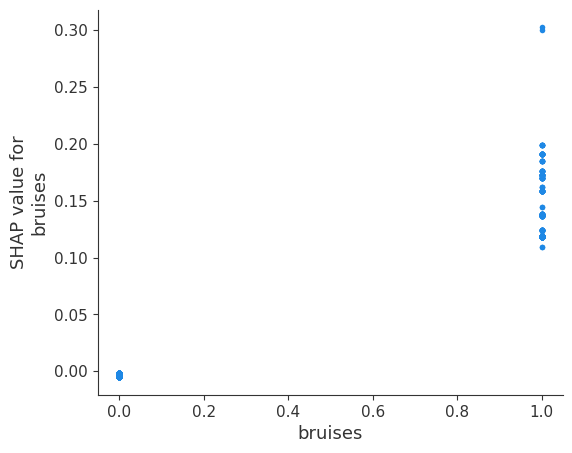

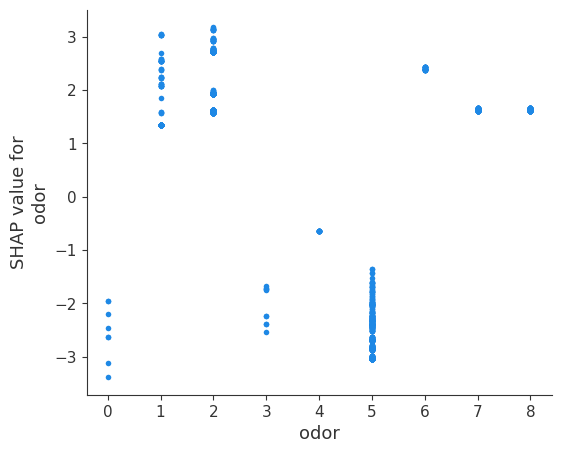

...

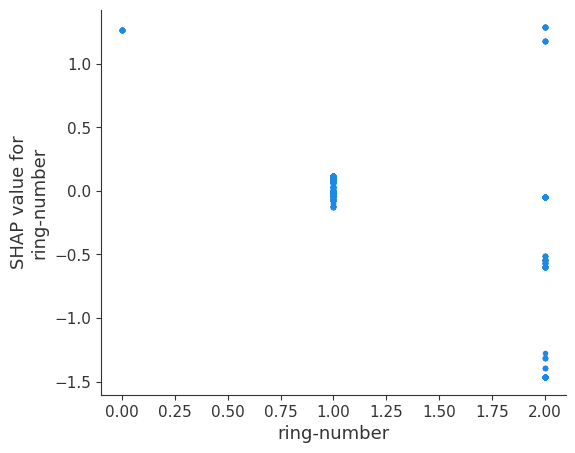

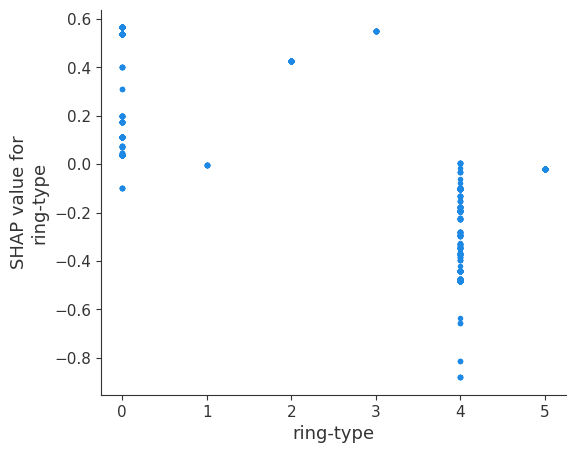

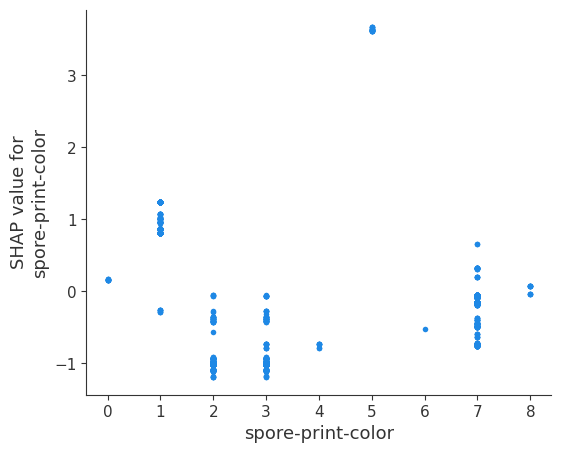

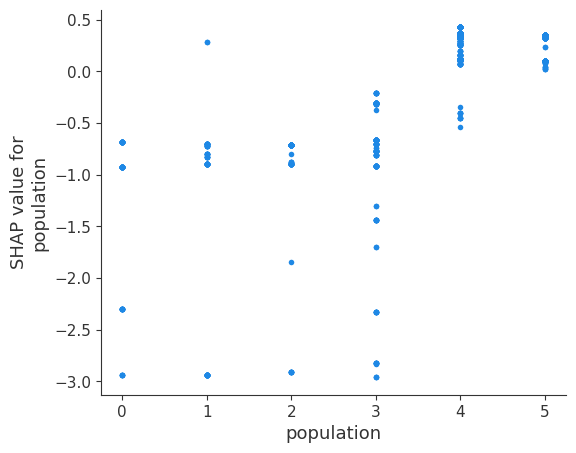

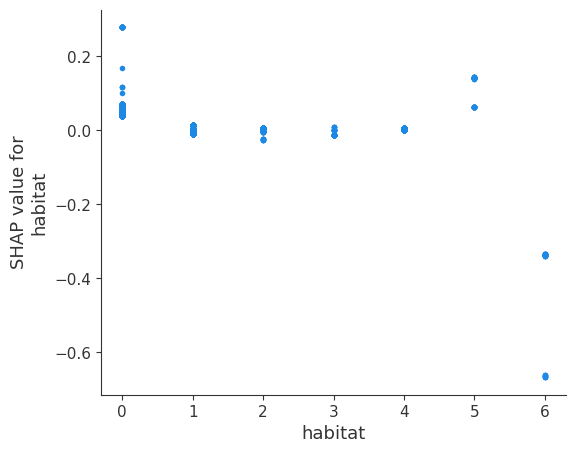

In [55]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_GBC_15, X15_test,interaction_index = None )





# noise level 20


In [56]:
data_20 = noise_addition(0.2)
print(data_20.groupby('odor').size())

odor
a      18
c     192
f    3784
l      18
m      36
n    2861
p      63
s     576
y     576
dtype: int64


In [57]:
labelencoder=LabelEncoder()
for col in data_20.columns:
    data_20[col] = labelencoder.fit_transform(data_20[col])

data_20.head()

,class,cap-shape,cap-surface,cap-color,bruises,odor,gill-attachment,gill-spacing,gill-size,gill-color,...,stalk-surface-below-ring,stalk-color-above-ring,stalk-color-below-ring,veil-type,veil-color,ring-number,ring-type,spore-print-color,population,habitat
1971,0,2,0,4,0,5,1,1,0,3,...,0,7,7,0,2,1,0,3,3,1
6654,1,2,2,2,0,8,1,0,1,0,...,2,6,6,0,2,1,0,7,4,2
5606,1,4,3,4,0,2,1,0,1,0,...,2,7,6,0,2,1,0,7,4,2
3332,0,2,3,3,1,5,1,0,0,5,...,2,3,6,0,2,1,4,3,5,0
6988,1,2,2,2,0,7,1,0,1,0,...,2,6,6,0,2,1,0,7,4,2


In [58]:
X_20 = data_20.iloc[:,1:23]  # all rows, all the features and no labels
y_20 = data_20.iloc[:, 0]  # all rows, label only
X_20.head()
y_20.head()

1971    0
6654    1
5606    1
3332    0
6988    1
Name: class, dtype: int64

In [59]:
X20_train, X20_test, y20_train, y20_test = train_test_split(X_20,y_20,test_size=0.2,random_state=42)

In [62]:
# model
model_tree20 = DecisionTreeClassifier()
model_tree20.fit(X20_train, y20_train)

# prediction
y_pred20 = model_tree20.predict(X20_test)

model_tree20.score(X20_test, y_pred20)


1.0

In [63]:
print(classification_report(y20_test,y_pred20))

              precision    recall  f1-score   support

           0       0.94      1.00      0.97       840
           1       1.00      0.93      0.97       785

    accuracy                           0.97      1625
   macro avg       0.97      0.97      0.97      1625
weighted avg       0.97      0.97      0.97      1625



In [65]:
shap.initjs()
explainer_DT_20 = shap.TreeExplainer(model_tree20)
shap_values_DT_20 = explainer_DT_20.shap_values(X20_test)
shap.force_plot(explainer_DT_20.expected_value[0], shap_values_DT_20[0], X20_test)


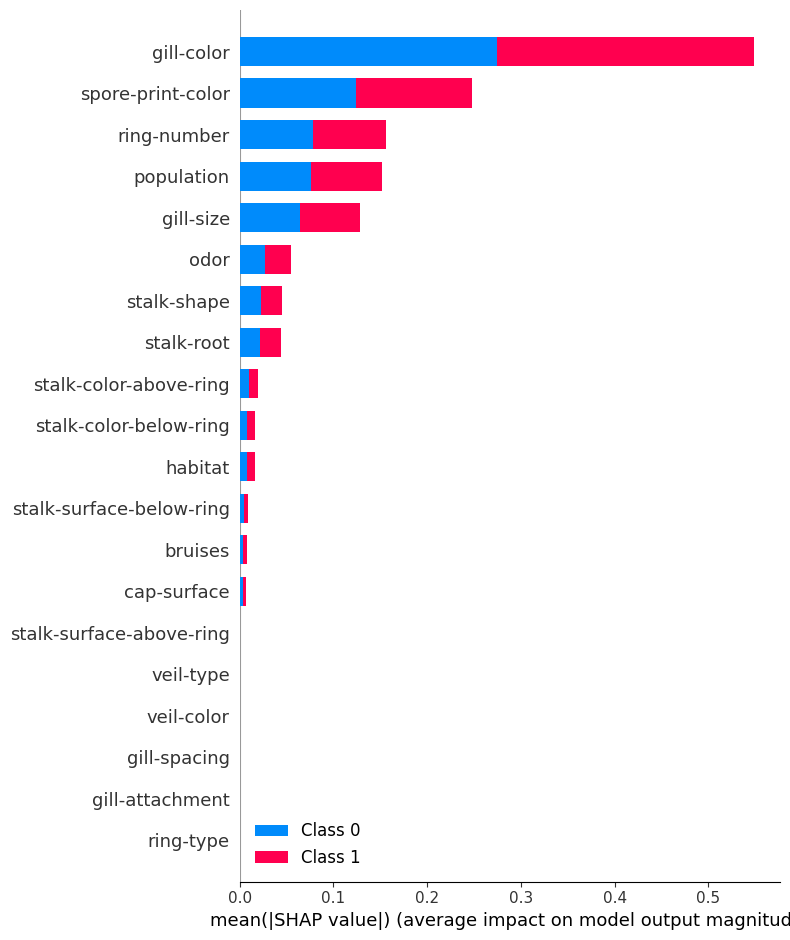

In [66]:
shap.initjs()
shap.summary_plot(shap_values_DT_20, X20_test, plot_type="bar")

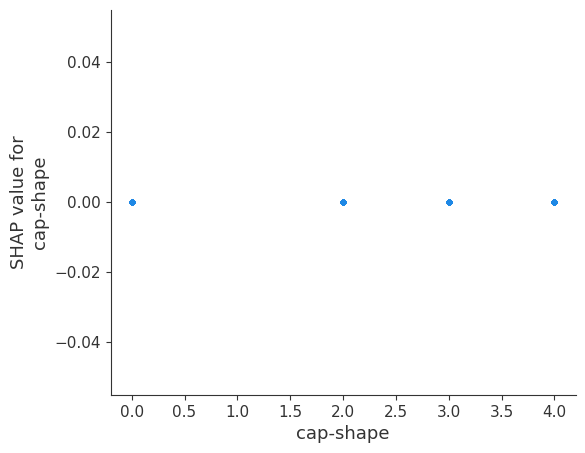

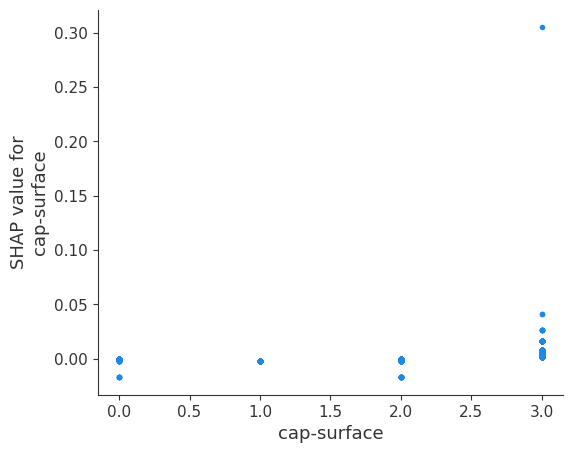

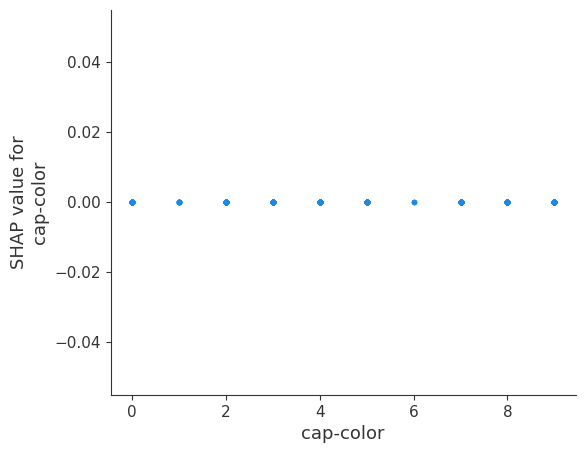

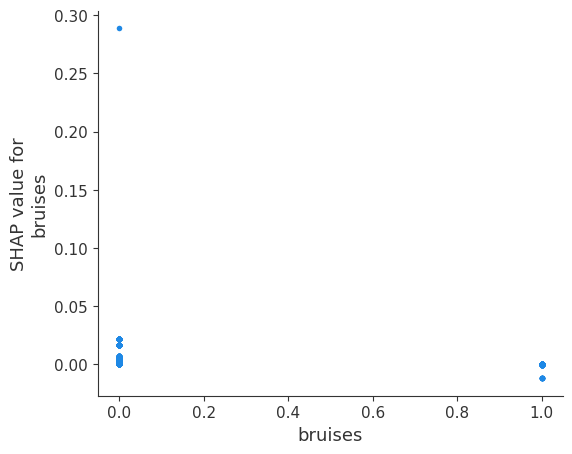

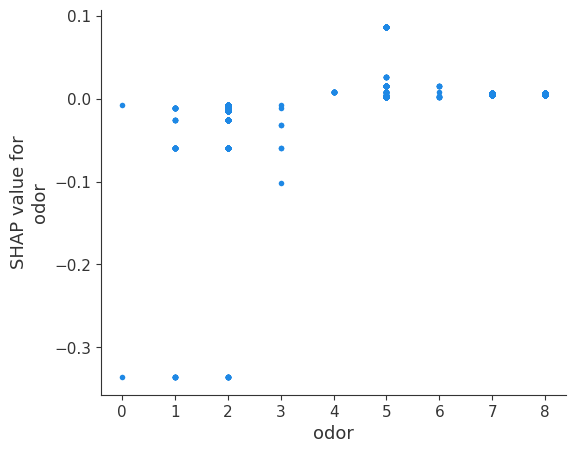

...

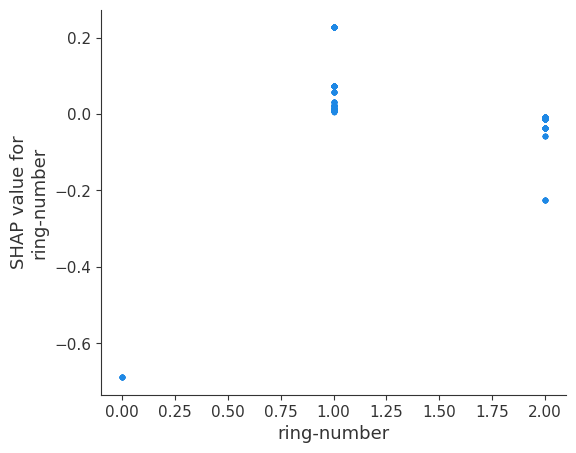

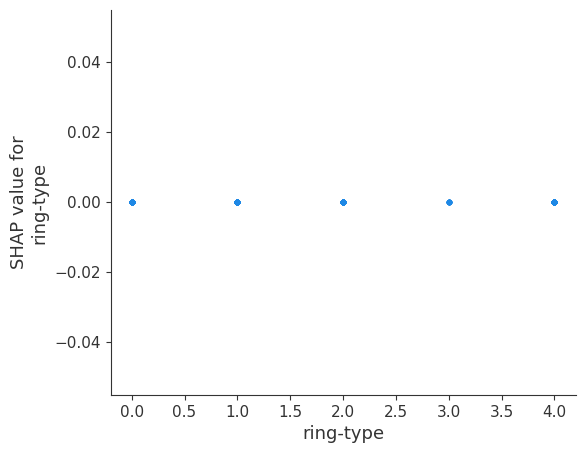

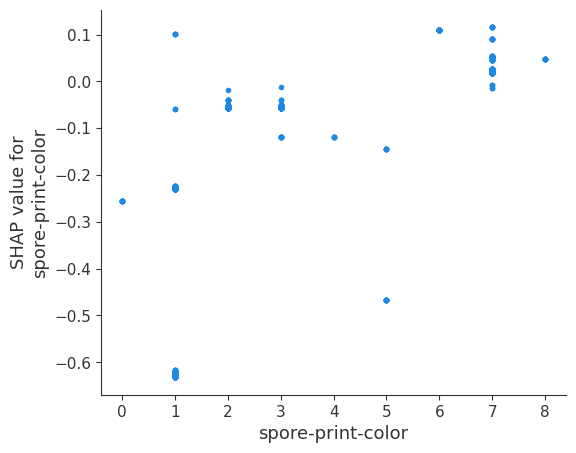

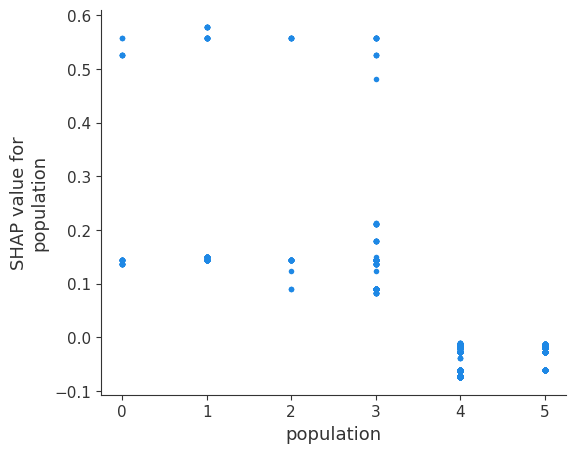

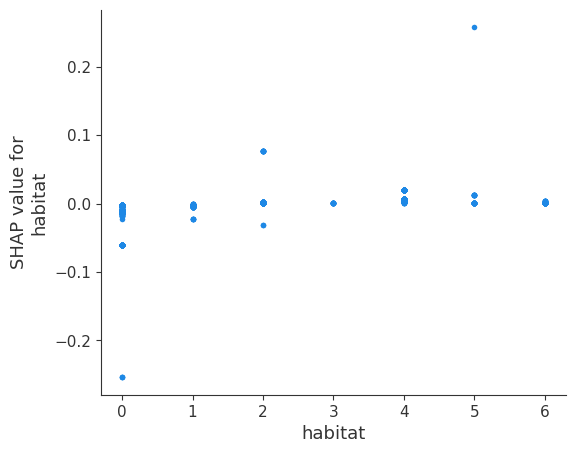

In [67]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_DT_20[0], X20_test,interaction_index = None )

In [68]:
gbc20 = GradientBoostingClassifier(random_state=10,validation_fraction=0.2)
gbc20.fit(X20_train,y20_train)


GradientBoostingClassifier(random_state=10, validation_fraction=0.2)

In [69]:


# prediction
y_pred_gbc20 = gbc20.predict(X20_test)

gbc20.score(X20_test, y_pred_gbc20)
# result
1

1

In [70]:
print(classification_report(y20_test,y_pred_gbc20))

              precision    recall  f1-score   support

           0       0.94      1.00      0.97       840
           1       1.00      0.93      0.96       785

    accuracy                           0.97      1625
   macro avg       0.97      0.97      0.97      1625
weighted avg       0.97      0.97      0.97      1625



In [71]:
shap.initjs()
explainer_GBC_20 = shap.TreeExplainer(gbc20)
shap_values_GBC_20 = explainer_GBC_20.shap_values(X20_test)
shap.force_plot(explainer_GBC_20.expected_value[0], shap_values_GBC_20, X20_test)


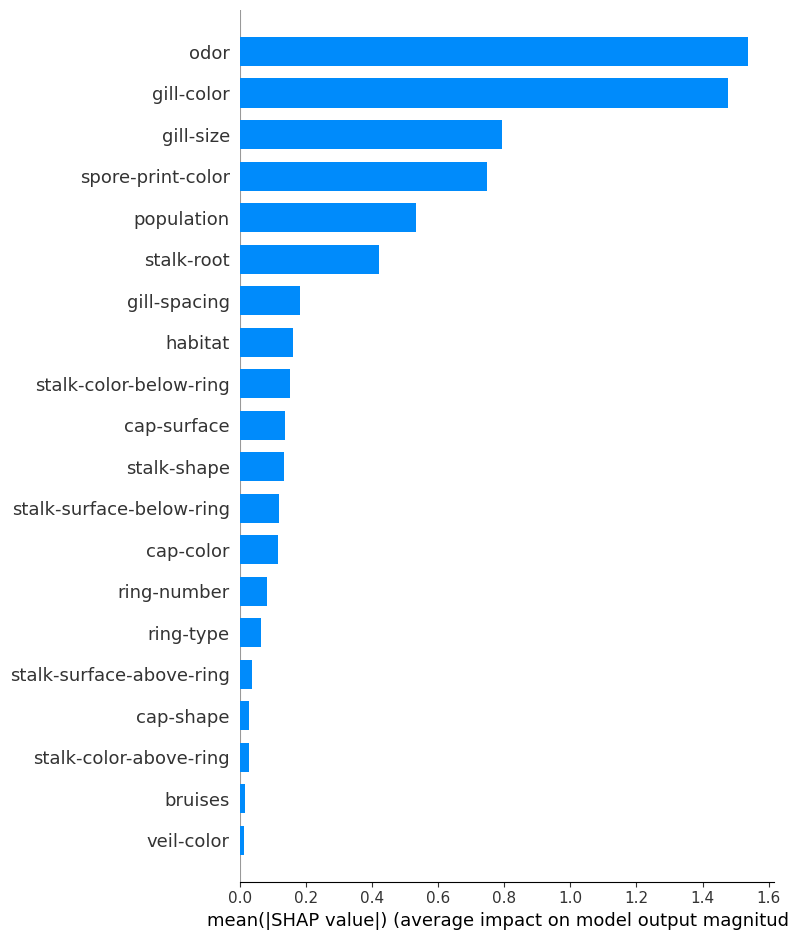

In [72]:
shap.initjs()
shap.summary_plot(shap_values_GBC_20, X20_test, plot_type="bar")

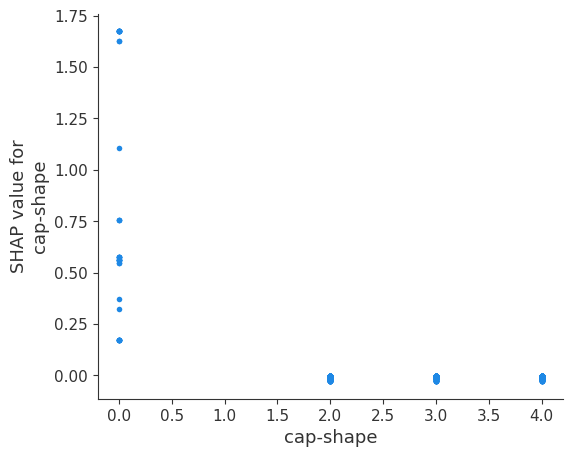

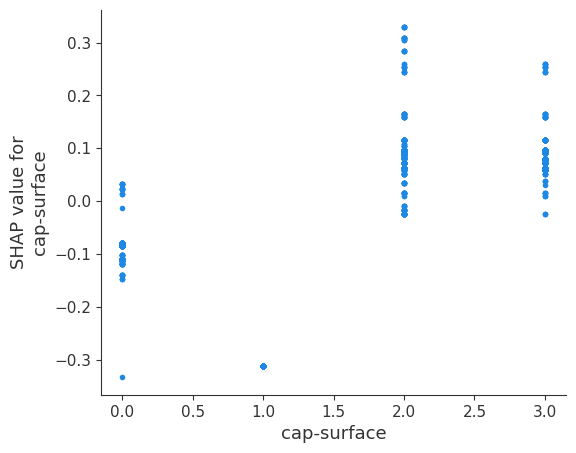

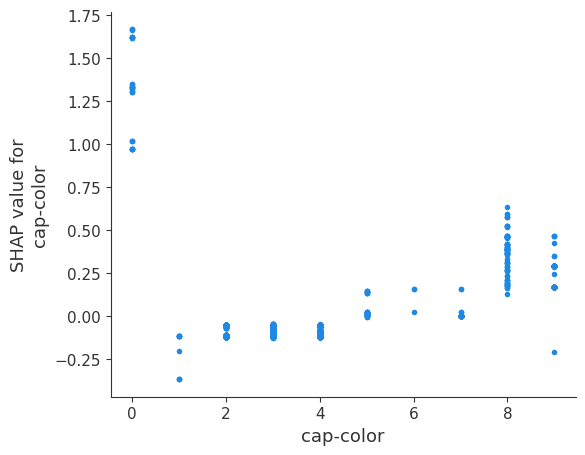

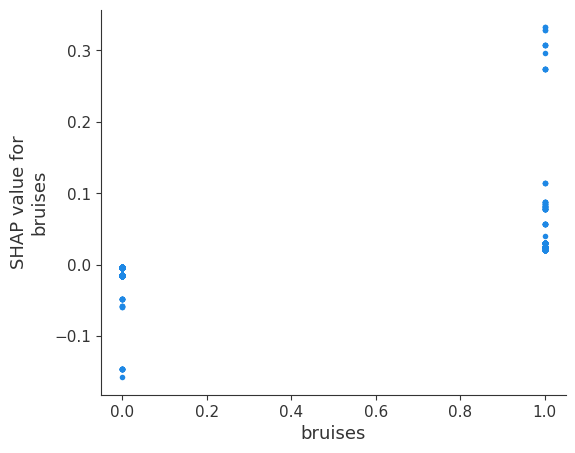

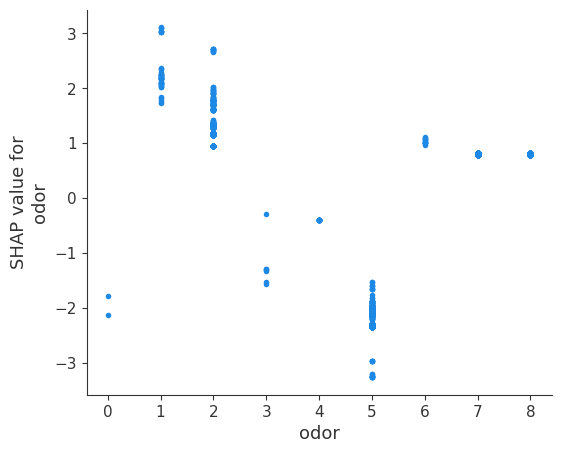

...

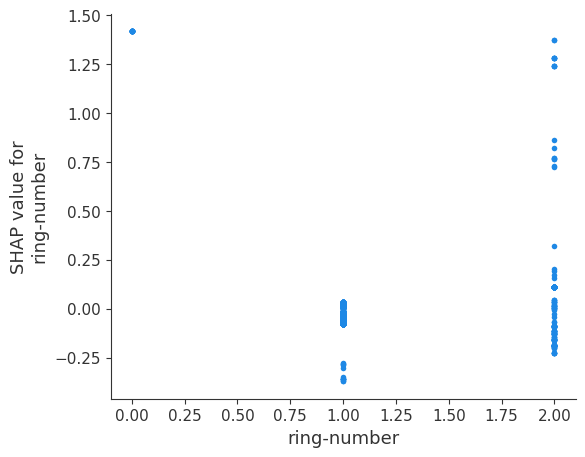

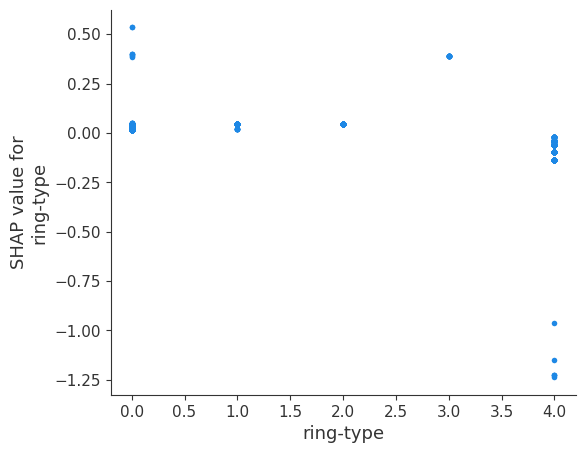

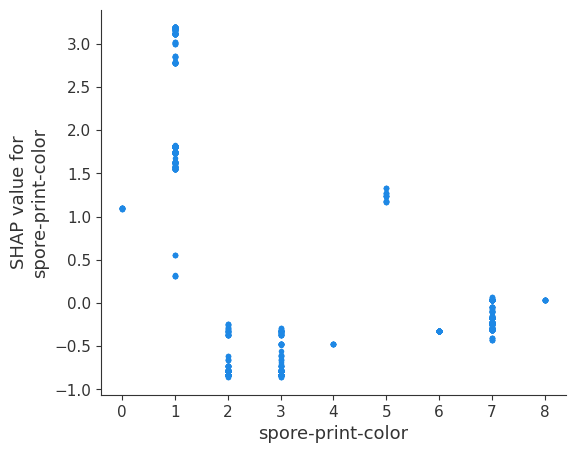

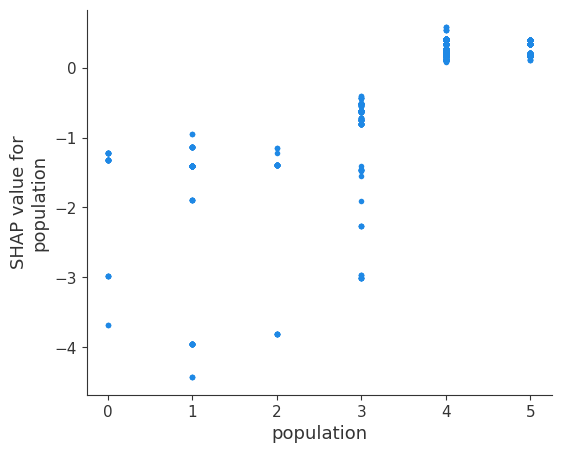

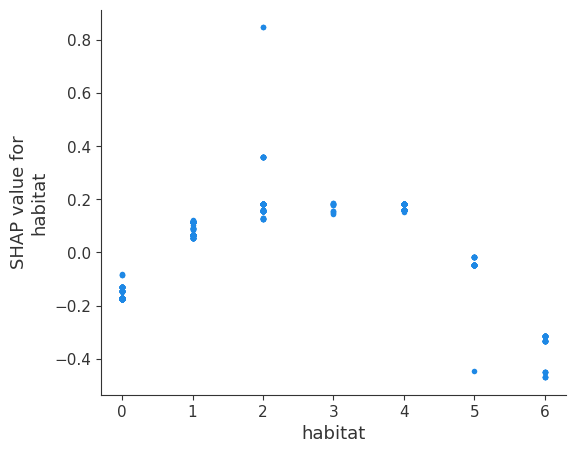

In [73]:
shap.initjs()
for name in X_display.columns:
  shap.dependence_plot(name, shap_values_GBC_20, X20_test,interaction_index = None )